# Overview

- Using the same setup as V vs. B testing and V vs. Temp
- With same probe in place, run temperature schedule (14 deg C - 30 deg C, 2 deg C steps) for several magnet currents
- Do a multidimensional fit of |V| vs. B, Temp
    - Polynomial of n and m degrees
    - Try with Chebyshev polynomials
- For each current:
    - Run temperature schedule
    - $>=4$ hours to cool back to 14 deg C + magnet current change settles
- Slow controls (main): 5 seconds between measurements, Hall probe, NMR, magnet current + voltage, Zaber readout, SmarAct readout
- Slow controls (temperatures): read out all slow control temperature probes every 3 minutes
- Adding data for low field NMR

# Imports

In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [4]:
import numpy as np
import pandas as pd
from datetime import datetime
from datetime import timedelta
from pandas.api.types import is_numeric_dtype
from scipy.interpolate import interp1d
import lmfit as lm
from copy import deepcopy
#from dateutil import parser
from plotly import graph_objects as go
from plotly.offline import plot
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
%matplotlib inline

# local imports
from plotting import config_plots, datetime_plt
from load_slow import *
from Zaber_Magnet_Convert import *
# hallprobecalib package
from hallprobecalib.hpcplots import scatter3d, scatter2d, histo
from mu2e.mu2eplots import mu2e_plot3d

In [5]:
config_plots()

In [6]:
ddir = '/home/ckampa/Dropbox/LogFiles/'

In [7]:
# 7-21-21 12:58, probe 8, temperature effects -- using cooling schedule on PGC control software
# 12 deg C to 30 deg C, 1 deg step. Ramp 1 deg over 10 min, dwell for 30 min.
# After last step, ramp down to 12 deg C in 5 seconds, dwell for 3 hr 30 min to restart loop.
######
# Later started 2 deg steps 14 deg C to 30 deg C for several magnet currents
#plotdir = '/home/ckampa/data/hallprobecalib_extras/plots/hall_probe_B_T/07-21-21_12:58/'
#slowfile = ddir+'2021-07-21 125802slow.txt'
#slowtempfile = ddir+'2021-07-21 125810slow.txt'

In [72]:
plotdir = '/home/ckampa/data/hallprobecalib_extras/plots/hall_probe_B_T/08-05-21_15:30/'
slowfile = ddir+'2021-07-21 125802slow.txt'
slowtempfile = ddir+'2021-07-21 125810slow.txt'

In [73]:
slowfile2 = ddir + '2021-08-05 153029slow.txt'
slowtempfile2 = ddir + '2021-08-05 152137slow.txt'

In [74]:
slowfile3 = ddir + '2021-08-10 143911slow.txt'
slowtempfile3 = ddir + '2021-08-10 142829slow.txt'

In [75]:
slowfile4 = ddir + "2021-08-12 144504slow (TD-135768's conflicted copy 2021-08-31).txt"
slowtempfile4 = ddir + "2021-08-12 142813slow (TD-135768's conflicted copy 2021-08-31).txt"

In [76]:
slowfiles = [slowfile, slowfile2, slowfile3, slowfile4]
slowtempfiles = [slowtempfile, slowtempfile2, slowtempfile3, slowtempfile4]

# Load Data

In [181]:
df_temps = []
for st in slowtempfiles:
    df_temps.append(load_data(st))

df_temp = pd.concat(df_temps, ignore_index=False)
df_temp['seconds_delta'] = (df_temp.index - df_temp.index[0]).total_seconds()
df_temp['hours_delta'] = (df_temp.index - df_temp.index[0]).total_seconds()/60**2
df_temp['days_delta'] = (df_temp.index - df_temp.index[0]).total_seconds()/(24*60**2)

In [182]:
#df_temp

In [183]:
len(df_temp)

16639

In [242]:
df_temp.hours_delta.describe()

count    16639.000000
mean       441.940663
std        265.422518
min          0.000000
25%        207.931111
50%        420.645278
75%        682.391389
max        890.381111
Name: hours_delta, dtype: float64

In [184]:
df_temp.tail()

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1,Coil 2,LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke (near pole),...,ICW He2 out,LCW return magnet,LCW to barrel,LCW from PS,LCW to magnet,NMR [T],NMR [FFT],seconds_delta,hours_delta,days_delta
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-27 15:09:03,8/27/2021 3:09:03 PM,0.0,0.0,32.272701,32.134800,31.548080,30.699881,29.272407,31.927872,23.864052,...,29.315474,31.448456,30.086941,34.272358,32.009914,0.0,0.0,3204652.0,890.181111,37.090880
2021-08-27 15:12:03,8/27/2021 3:12:03 PM,0.0,0.0,32.302738,32.166431,31.633719,30.810240,29.321459,31.957058,23.873331,...,29.326422,31.459885,30.098936,34.294918,32.052185,0.0,0.0,3204832.0,890.231111,37.092963
2021-08-27 15:15:03,8/27/2021 3:15:03 PM,0.0,0.0,32.320396,32.175263,31.562742,30.724033,29.401566,31.976784,23.873508,...,29.313051,31.438723,30.098267,34.296616,32.045032,0.0,0.0,3205012.0,890.281111,37.095046
2021-08-27 15:18:03,8/27/2021 3:18:03 PM,0.0,0.0,32.349804,32.194241,31.574171,30.740049,29.376892,31.923260,23.868397,...,29.329613,31.512968,30.125309,34.305351,32.044281,0.0,0.0,3205192.0,890.331111,37.097130
2021-08-27 15:21:03,8/27/2021 3:21:03 PM,0.0,0.0,32.352089,32.184170,31.601362,30.782837,29.297062,31.996649,23.878168,...,29.356846,31.532377,30.159916,34.356941,32.098618,0.0,0.0,3205372.0,890.381111,37.099213


In [185]:
## FIXME! only read in first line to get header
df_headers = load_data(slowfile, header=None)
cols = list(df_headers.columns)

In [186]:
#cols[0:3]

In [187]:
#cols[44:-6]

In [188]:
# ACCOUNTS FOR FLIPPED MICRON/ENCODER
main_header = cols[0:3] + cols[43:53] +\
['Zaber_Meas_Micron_X', 'Zaber_Meas_Encoder_X', 'Zaber_Meas_Micron_Y', 'Zaber_Meas_Encoder_Y',
 'Zaber_Meas_Micron_Z', 'Zaber_Meas_Encoder_Z'] + cols[59:-6] #+ ['']
#main_header

In [189]:
len(main_header)

23

In [190]:
# main data
dfs = []
for s in slowfiles:
    dfs.append(load_data(s, header=main_header))

df = pd.concat(dfs, ignore_index=False)
df['seconds_delta'] = (df.index - df.index[0]).total_seconds()
df['hours_delta'] = (df.index - df.index[0]).total_seconds()/60**2
df['days_delta'] = (df.index - df.index[0]).total_seconds()/(24*60**2)

In [243]:
df.hours_delta.describe()

count    111762.000000
mean        366.720924
std         253.236231
min           0.000000
25%         155.225486
50%         310.467222
75%         574.264583
max         890.411667
Name: hours_delta, dtype: float64

In [244]:
df.tail()

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,magnet_Z_mm,2F0000000D5EC73A_Raw_Bmag,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W]
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-27 15:14:13,8/27/2021 3:14:13 PM,90.521373,10.946018,0.0,0.0,-16690.0,-20365.0,-678113.0,17804.0,0.245399,...,768.654297,678623.997582,3.102783,-2.257341,0.245795,1.527096,-0.036197,0.120922,0.241844,990.848612
2021-08-27 15:16:21,8/27/2021 3:16:21 PM,90.521543,10.946283,0.0,0.0,-16690.0,-20365.0,-678113.0,17804.0,0.245399,...,768.654297,678623.997582,3.102783,-2.257341,0.245795,1.527096,-0.036197,0.120925,0.241849,990.874461
2021-08-27 15:18:29,8/27/2021 3:18:29 PM,90.521317,10.946432,0.0,0.0,-16690.0,-20365.0,-678113.0,17804.0,0.245399,...,768.654297,678623.997582,3.102783,-2.257341,0.245795,1.527096,-0.036197,0.120927,0.241853,990.885407
2021-08-27 15:20:37,8/27/2021 3:20:37 PM,90.521487,10.946643,0.0,0.0,-16690.0,-20365.0,-678113.0,17804.0,0.245399,...,768.654297,678623.997582,3.102783,-2.257341,0.245795,1.527096,-0.036197,0.120929,0.241857,990.906429
2021-08-27 15:22:45,8/27/2021 3:22:45 PM,90.521600,10.947215,0.0,0.0,-16690.0,-20365.0,-678113.0,17804.0,0.245399,...,768.654297,678623.997582,3.102783,-2.257341,0.245795,1.527096,-0.036197,0.120935,0.241870,990.959417


In [245]:
def get_probe_IDs(df):
    probes = [c[:-6] for c in df.columns if "Raw_X" in c]
    return sorted(probes)

In [246]:
probes = get_probe_IDs(df)
probe = probes[0]

In [247]:
probes, probe

(['2F0000000D5EC73A'], '2F0000000D5EC73A')

In [248]:
# Hall probe calculations
for p in probes:
    for t in ['Raw', 'Cal']:
        df[f'{p}_{t}_Bmag'] = (df[f'{p}_{t}_X']**2 + df[f'{p}_{t}_Y']**2 + df[f'{p}_{t}_Z']**2)**(1/2)
        df[f'{p}_{t}_Theta'] = np.arccos(df[f'{p}_{t}_Z']/df[f'{p}_{t}_Bmag'])
        df[f'{p}_{t}_Phi'] = np.arctan2(df[f'{p}_{t}_Y'],df[f'{p}_{t}_X'])

In [196]:
df['Magnet Resistance [Ohm]'] = df['Magnet Voltage [V]'] / df['Magnet Current [A]']
df['Coil Resistance [Ohm]'] = 2*df['Magnet Resistance [Ohm]']
df['Magnet Power [W]'] = df['Magnet Voltage [V]'] * df['Magnet Current [A]']

In [197]:
#t0 = '2021-07-25 18:00' # probe 8, 7-21
t0 = '2021-07-25 09:15' # probe 8, 7-21
# t0 = '2021-07-25 09:00' # probe 8, 7-21
#tf = '2021-08-02 00:00' # probe 8, 7-21, all scheduled ramps
#tf = '2021-08-05 00:00' # probe 8, 7-21, all scheduled ramps
tf = '2021-08-14 00:00'

# df_ = df.query(f'"{t0}" <= Datetime <= "{tf}"').copy()
#df_ = df.query(f'("{t0}" <= Datetime <= "{tf}") and (`NMR [T]` > 0.68)').copy()
df_ = df.query(f'("{t0}" <= Datetime <= "{tf}") and (`NMR [T]` > 0.2)').copy()

In [198]:
len(df_), len(df)

(66199, 111762)

In [199]:
df_temp_ = df_temp.query(f'"{t0}" <= Datetime <= "{tf}"').copy()

In [200]:
len(df_temp_), len(df_temp)

(8245, 16639)

/tmp/ipykernel_2251242/1743968442.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



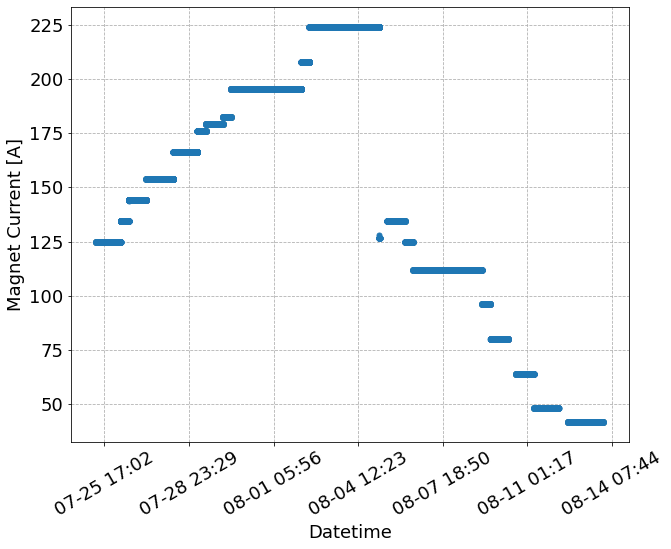

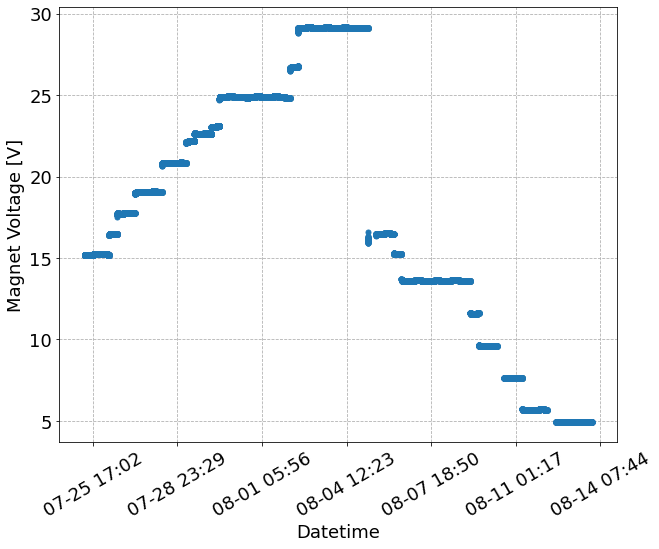

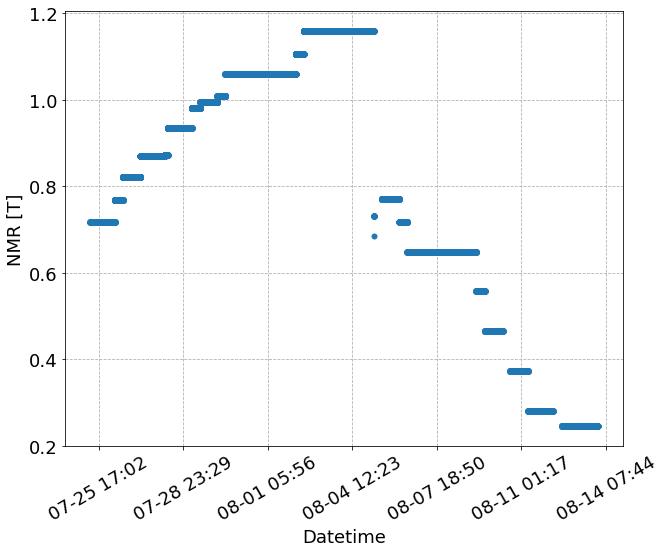

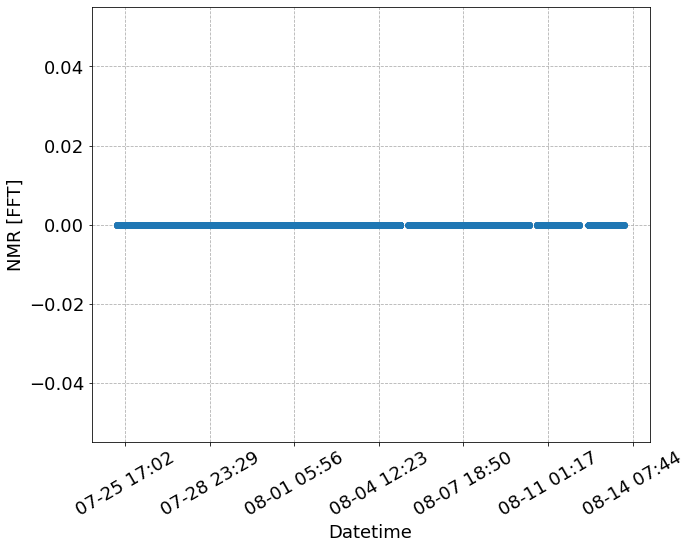

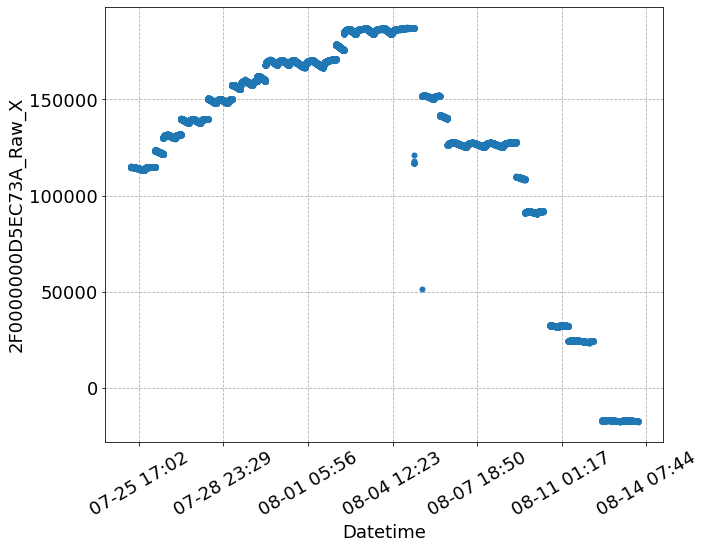

...

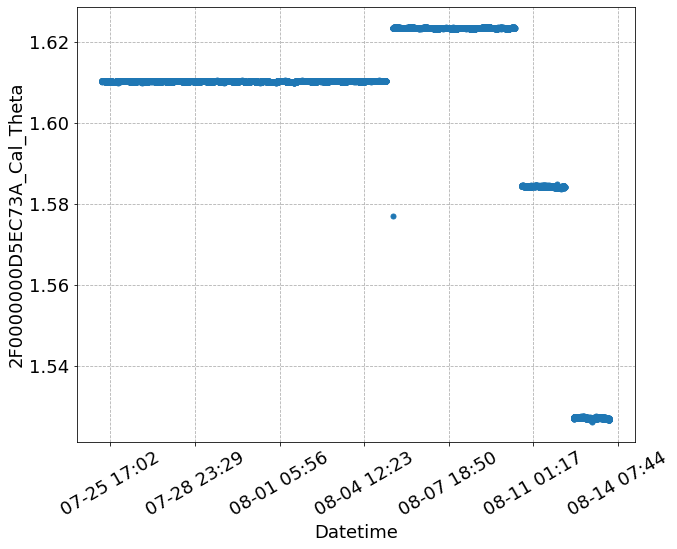

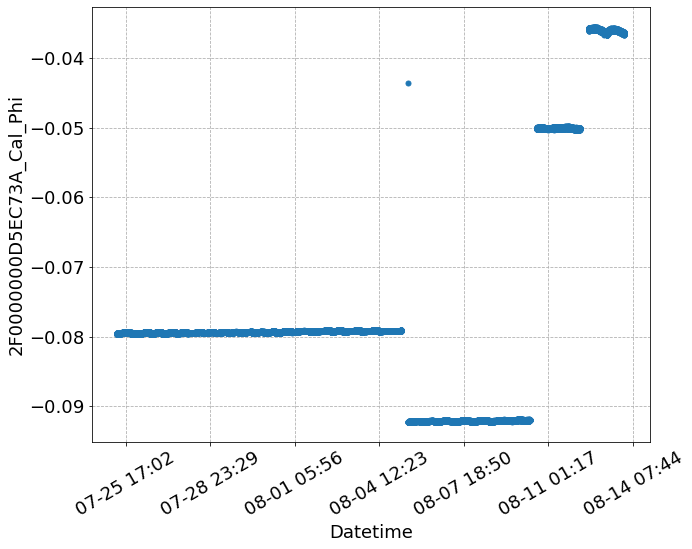

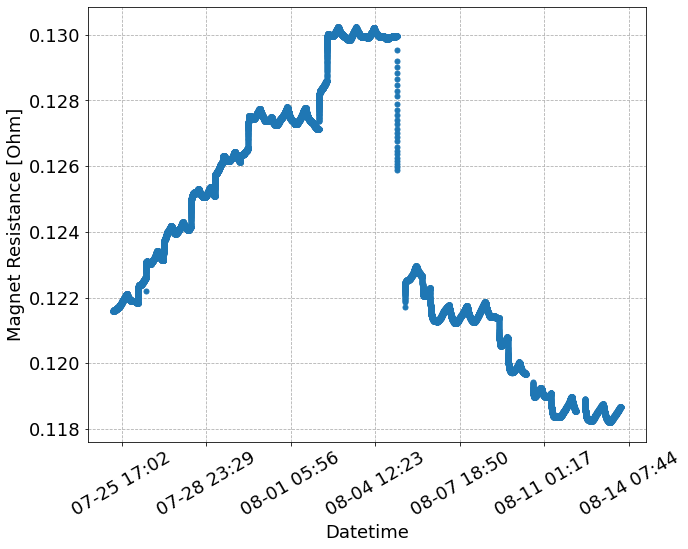

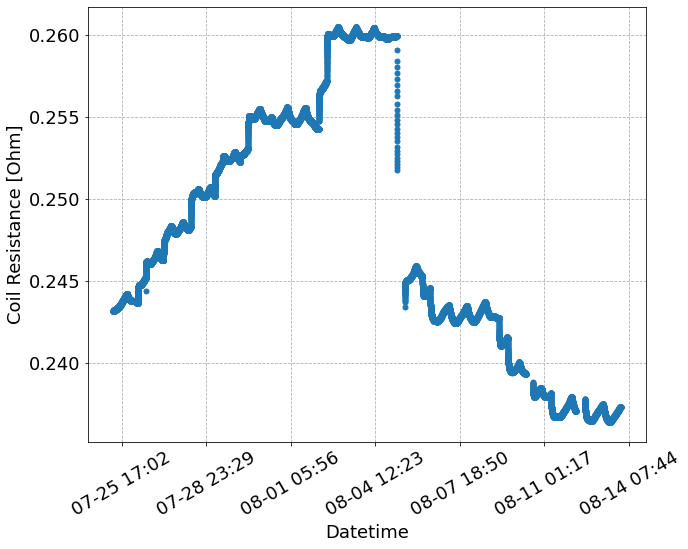

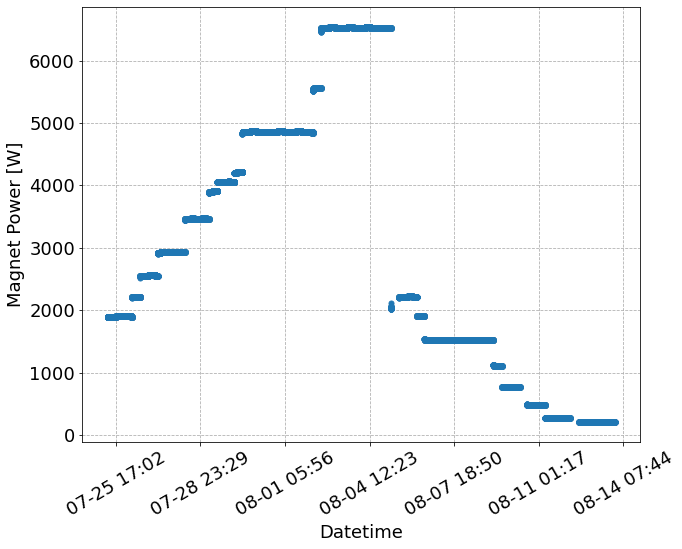

In [201]:
# plot vs. time
for col in df_.columns:
    if is_numeric_dtype(df_[col]):
        fig, ax = plt.subplots()
        ax = datetime_plt(ax, df_.index, df_[col], nmaj=6, Locator='Minute')
        ax.set_xlabel('Datetime')
        ax.set_ylabel(col)

/tmp/ipykernel_2251242/2477770201.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



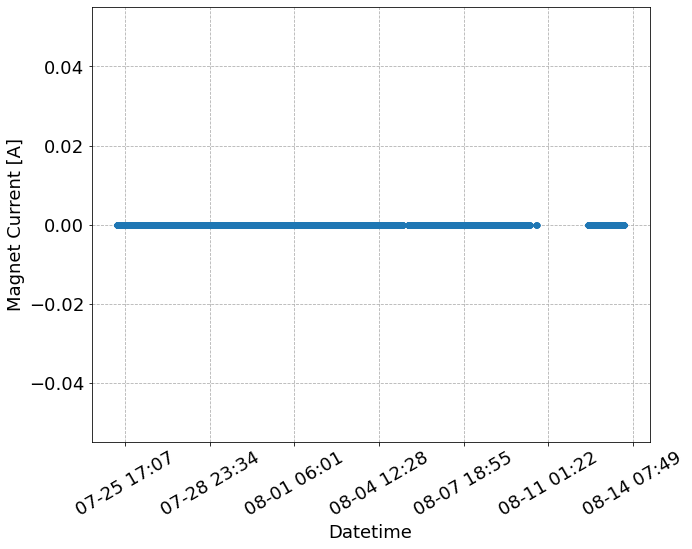

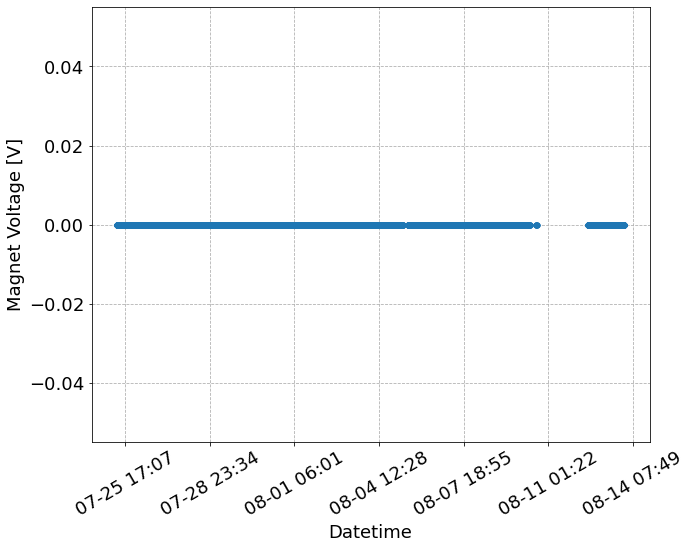

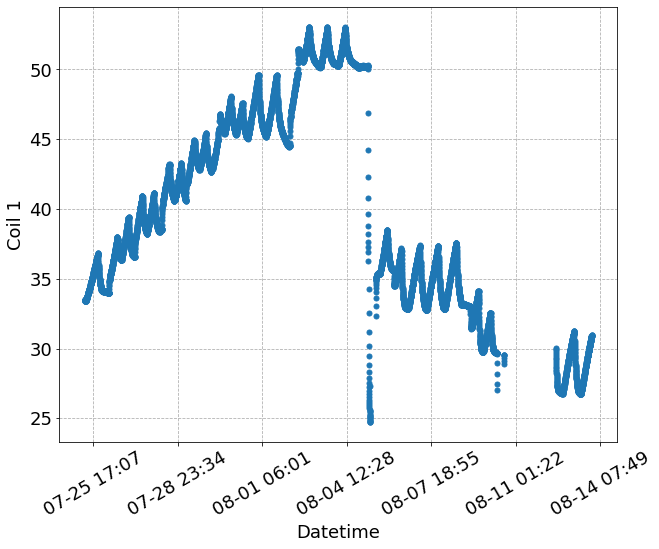

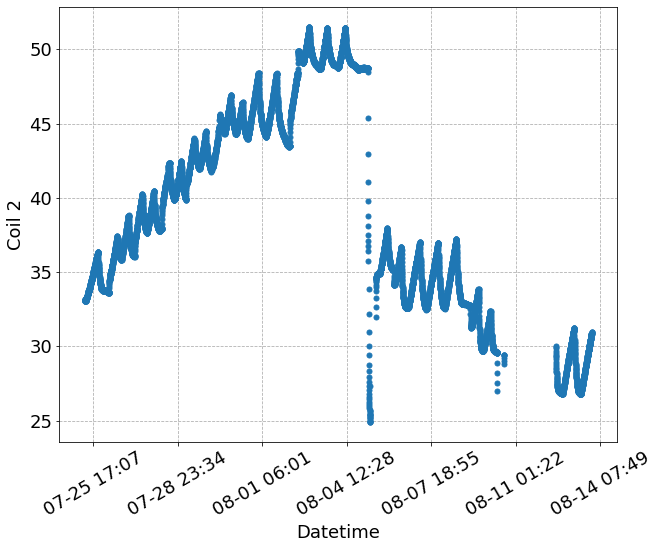

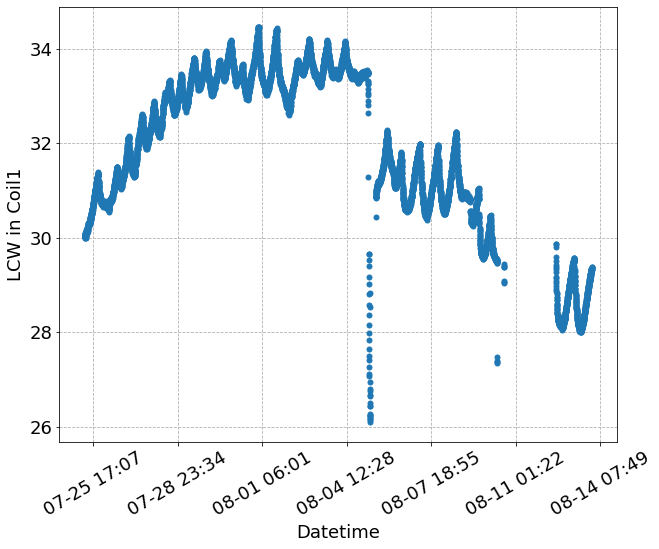

...

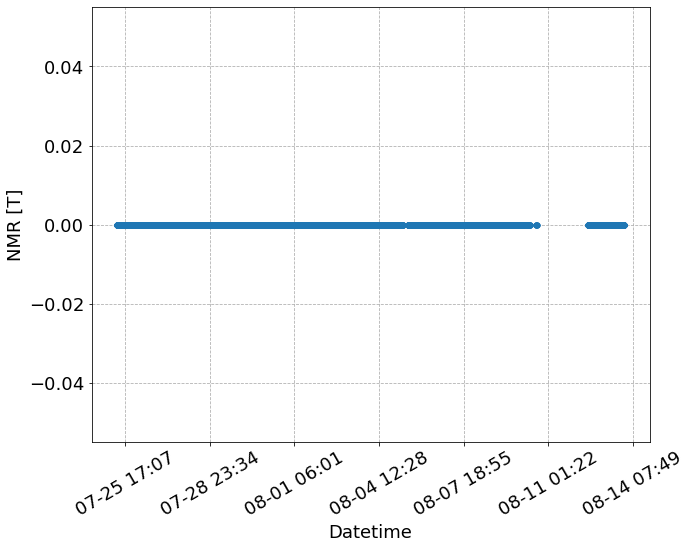

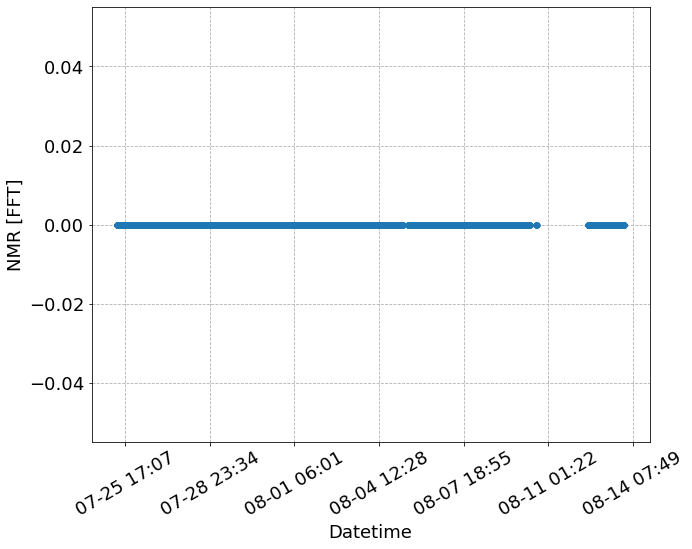

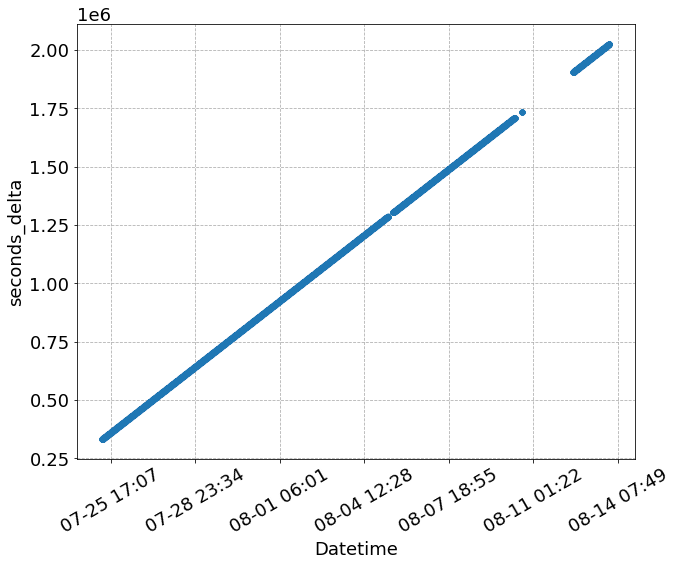

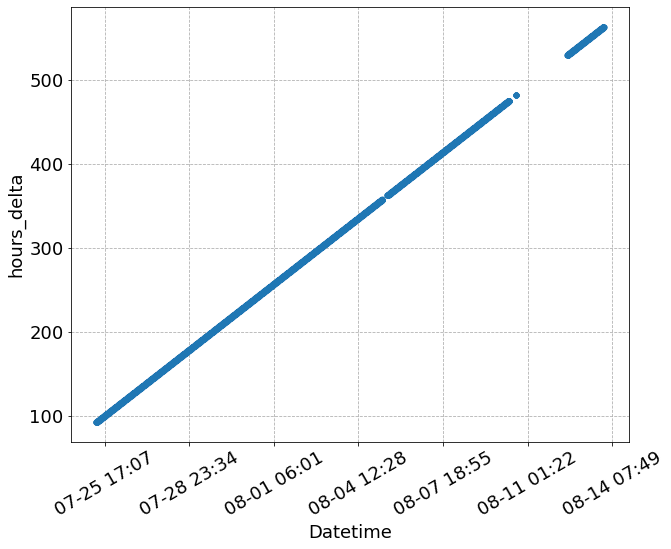

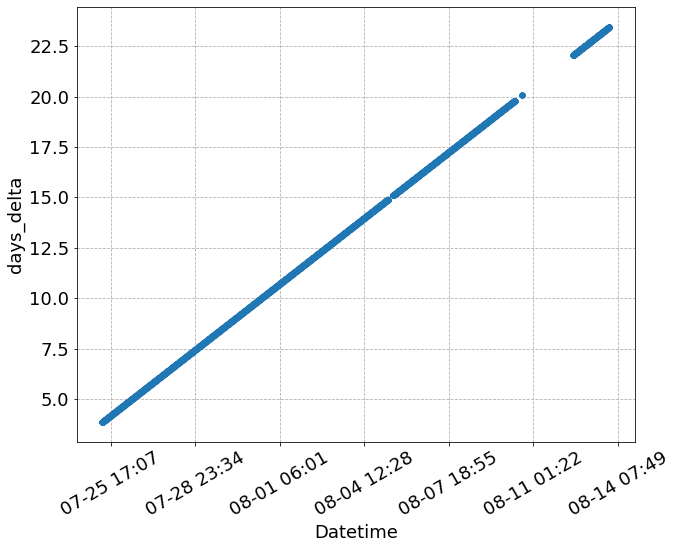

In [202]:
# plot vs. time
for col in df_temp_.columns:
    if is_numeric_dtype(df_temp_[col]):
        fig, ax = plt.subplots()
        ax = datetime_plt(ax, df_temp_.index, df_temp_[col], nmaj=6, Locator='Minute')
        ax.set_xlabel('Datetime')
        ax.set_ylabel(col)

- What happened with the jump in Zaber Z coordinate + jump in SmarAct angle 1 by 1 deg? (07-15-21)

In [203]:
#fig = scatter2d(df_.index, df_['Magnet Current [A]'], markers=True, lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [204]:
# looking at angles in HP and SmarAct

In [205]:
a1 = df_['SmarAct_Meas_Angle_1'].values * np.pi / 180.
a2 = df_['SmarAct_Meas_Angle_2'].values * np.pi / 180.

In [206]:
r_th = df_[f'{probe}_Raw_Theta'].values
r_ph = df_[f'{probe}_Raw_Phi'].values
c_th = df_[f'{probe}_Cal_Theta'].values
c_ph = df_[f'{probe}_Cal_Phi'].values

In [207]:
len(a1), len(r_th)

(66199, 66199)

In [208]:
# raw

In [209]:
df_[f'{probe}_Raw_Theta'].describe()

count    66199.000000
mean         3.049339
std          0.016982
min          3.029204
25%          3.047426
50%          3.047682
75%          3.047858
max          3.103515
Name: 2F0000000D5EC73A_Raw_Theta, dtype: float64

In [210]:
df_[f'{probe}_Raw_Theta'].max() - df_[f'{probe}_Raw_Theta'].min()

0.07431091248095889

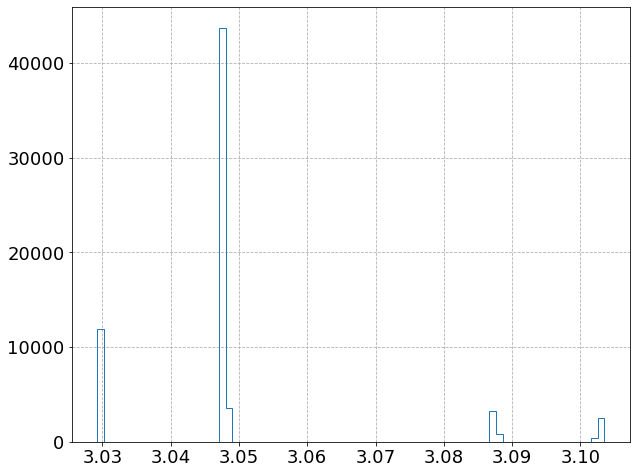

In [211]:
fig, ax = plt.subplots()
ax.hist(df_[f'{probe}_Raw_Theta'], bins=75, histtype='step');

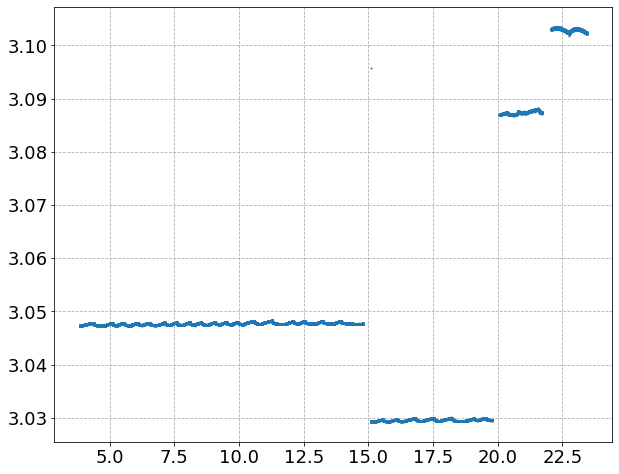

In [212]:
fig, ax = plt.subplots()
#ax.hist(df_[f'{probe}_Raw_Theta'], bins=75, histtype='step');
ax.scatter(df_['days_delta'], df_[f'{probe}_Raw_Theta'], s=1);

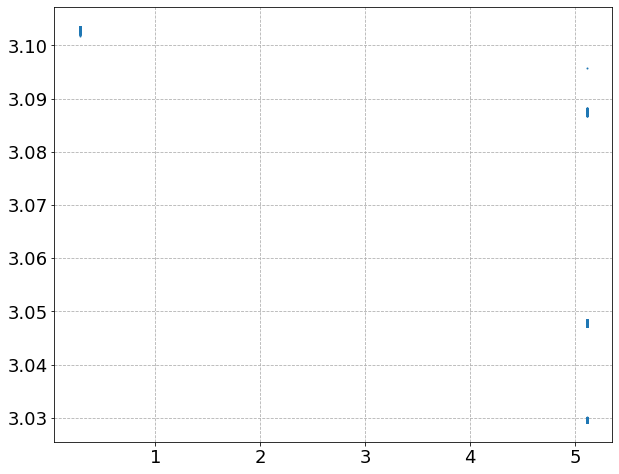

In [213]:
fig, ax = plt.subplots()
# ax.scatter(a1, r_th, s=1);
ax.scatter(a2, r_th, s=1);

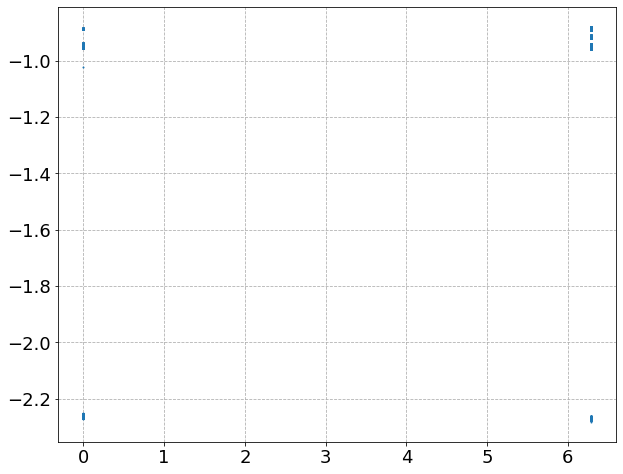

In [214]:
fig, ax = plt.subplots()
#ax.scatter(a2, r_ph, s=1);
ax.scatter(a1, r_ph, s=1);

In [215]:
# cal

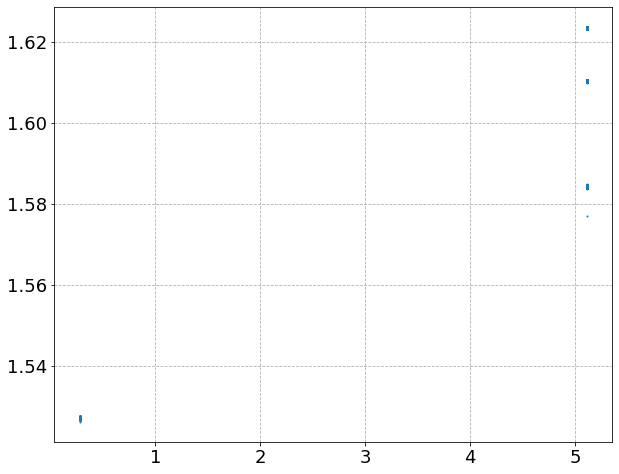

In [216]:
fig, ax = plt.subplots()
# ax.scatter(a1, c_th, s=1);
ax.scatter(a2, c_th, s=1);

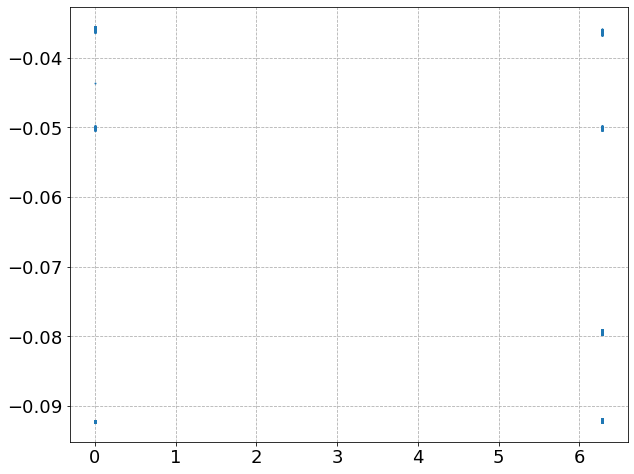

In [217]:
fig, ax = plt.subplots()
# ax.scatter(a2, c_ph, s=1);
ax.scatter(a1, c_ph, s=1);

## Select Times for Runs

In [218]:
df2_ = df_.query('"2021-08-05" < Datetime < "2021-08-14"')
df_temp2_ = df_temp_.query('"2021-08-05" < Datetime < "2021-08-14"')

In [219]:
fig = scatter2d([df2_.index, df_temp2_.index], [df2_[f'{probe}_Cal_T'], df_temp2_['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

In [220]:
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.arange(14, 42, 2),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
              np.arange(14, 42, 2),

(array([14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38, 40]),)

In [221]:
                '2021-08-05 19:00',
                '2021-08-06 08:18',
                '2021-08-06 21:00',
                '2021-08-09 07:30',
                '2021-08-09 18:40',
                # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
                '2021-08-12 17:30'

'2021-08-12 17:30'

In [222]:
                '2021-08-06 02:09',
                '2021-08-06 15:15',
                '2021-08-07 08:33',
                '2021-08-09 14:51',
                '2021-08-10 01:57',
                # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
                '2021-08-13 07:37'

'2021-08-13 07:37'

In [223]:
ramp_Temps = [np.arange(12, 31, 1),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.delete(np.arange(14, 32, 2), np.where(np.arange(14, 32, 2) == 28)), # FIXME! (clean this up)
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.delete(np.arange(14, 32, 2), np.where(np.arange(14, 32, 2) == 28)), # FIXME! (clean this up)
              np.arange(14, 32, 2),
              ###np.arange(14, 42, 2), # repeat but to higher temperature
              np.arange(14, 32, 2), # Monday morning
              np.arange(14, 32, 2),
#               np.arange(14, 20, 2), # partial, updated through the day
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.arange(14, 42, 2),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
              np.arange(14, 42, 2),
             ]

In [224]:
# t0s = np.array(['2021-07-25 10:00',
t0s = np.array(['2021-07-25 09:21',
                '2021-07-26 08:10',
                '2021-07-26 19:05',
                '2021-07-27 07:50',
                '2021-07-28 09:00',
                '2021-07-29 08:00',
                '2021-07-29 18:50',
                '2021-07-30 07:37',
                '2021-07-30 18:00',
                ###'2021-07-31 15:15', # repeat but to higher temperature, #1
#                 '2021-08-01 06:40', # repeat but to higher temperature, #2
                '2021-08-02 07:45',
                '2021-08-02 18:40',
                '2021-08-05 19:00',
                '2021-08-06 08:18',
                '2021-08-06 21:00',
                '2021-08-09 07:30',
                '2021-08-09 18:40',
                # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
                '2021-08-12 17:30'
])

tfs = np.array(['2021-07-25 21:51:42',
                '2021-07-26 15:27',
                '2021-07-27 02:13',
                '2021-07-27 15:00',
                '2021-07-28 16:17',
                '2021-07-29 15:13', # CHECK THIS
                '2021-07-30 01:55',
                '2021-07-30 14:18', # CHECK THIS
                '2021-07-31 01:13',
#                 '2021-08-01 02:43', # repeat but to higher temperature, #1
                ###'2021-08-01 19:34', # repeat but to higher temperature, #2
                '2021-08-02 15:00',
                '2021-08-03 01:52',
                '2021-08-06 02:09',
                '2021-08-06 15:15',
                '2021-08-07 08:33',
                '2021-08-09 14:51',
                '2021-08-10 01:57',
                # MISSING AUGUST 11-12 HVAC DATA. SKIPPING RUNS FOR NOW
                '2021-08-13 07:37'
])

## Filtering out Ramp Portions

### PGC Logfile

- example from current time
    - 44405.503866 , 2021-07-28 12:05:35 (+- a few seconds)

In [249]:
# 2 day offset from what the time should be
# hour, min, second appears correct
pgc_origin_time = datetime(year=1900, month=1, day=1) - timedelta(days=2)
pgc_origin_time

datetime.datetime(1899, 12, 30, 0, 0)

In [250]:
# TEST by looking at time in PGC software and conversion here
# 2021-7-28 12:29:24
pgc_origin_time + timedelta(days=44405.520417)

datetime.datetime(2021, 7, 28, 12, 29, 24, 28800)

In [258]:
#pgc_file = ddir+'1811121_7-22-21_1553.txt'
pgc_files = [ddir+'1811121_7-22-21_1553.txt',
             ddir+'1811121_07-29-21_0800.txt',
             ddir+'1811121_08-05-21_0800.txt',
             ddir+'1811121_08-12-21_0800.txt',
            ]

In [259]:
df_pgc = []
for pgc_file in pgc_files:
    df_pgc_ = pd.read_csv(pgc_file, delim_whitespace=True, skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
    #df_pgc = pd.read_csv(pgc_file, delimiter=' ', skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
    df_pgc_ = df_pgc_[['Time', 'AP', 'RP', 'WP', 'AO', 'WO', 'AS']]
    for col in df_pgc_.columns:
        df_pgc_[col] = pd.to_numeric(df_pgc_[col], errors='coerce')
    pgc_col_dict = {'Time': 'Time Float', 'AP': 'Air Temperature', 'RP': 'Relative Humidity', 'WP': 'Water Temperature', 'AO': 'Air Output', 'WO': 'Water Output', 'AS': 'Air Set Point'}
    df_pgc_.rename(columns=pgc_col_dict, inplace=True)
    df_pgc_['Datetime'] = [pgc_origin_time + timedelta(days=days) for days in df_pgc_['Time Float']]
    df_pgc_.sort_values(by=['Datetime'], inplace=True)
    df_pgc_ = df_pgc_.set_index('Datetime')
    df_pgc.append(df_pgc_)
df_pgc = pd.concat(df_pgc, ignore_index=False)
df_pgc['hours_delta'] = (df_pgc['Time Float'] - df_pgc['Time Float'].min()) * 24.
df_pgc['seconds_delta'] = df_pgc['hours_delta'] * 60. * 60.
df_pgc['days_delta'] = df_pgc['hours_delta'] / 24.

In [260]:
df_pgc.hours_delta.describe()

count    233741.000000
mean        334.506533
std         193.190365
min           0.000000
25%         162.611376
50%         339.551376
75%         501.776376
max         664.093056
Name: hours_delta, dtype: float64

In [261]:
# Relative humidity limits of NMR
max_RH = 80 # @31 deg C (or lower)
min_RH = 50 # @40 deg C
T0 = 31
Tf = 40
# m = 

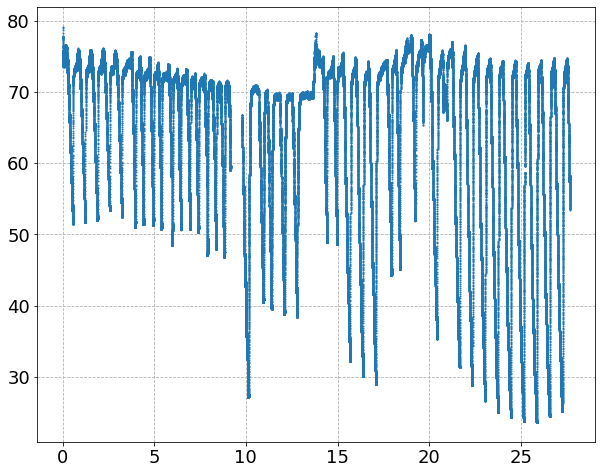

In [262]:
fig, ax = plt.subplots()
ax.scatter(df_pgc['days_delta'], df_pgc['Relative Humidity'], s=1)

In [263]:
# ORIGINAL
# df_pgc = pd.read_csv(pgc_file, delim_whitespace=True, skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
# #df_pgc = pd.read_csv(pgc_file, delimiter=' ', skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
# df_pgc = df_pgc[['Time', 'AP', 'RP', 'WP', 'AO', 'WO', 'AS']]
# for col in df_pgc.columns:
#     df_pgc[col] = pd.to_numeric(df_pgc[col], errors='coerce')
# pgc_col_dict = {'Time': 'Time Float', 'AP': 'Air Temperature', 'RP': 'Relative Humidity', 'WP': 'Water Temperature', 'AO': 'Air Output', 'WO': 'Water Output', 'AS': 'Air Set Point'}
# df_pgc.rename(columns=pgc_col_dict, inplace=True)
# df_pgc['Datetime'] = [pgc_origin_time + timedelta(days=days) for days in df_pgc['Time Float']]
# df_pgc.sort_values(by=['Datetime'], inplace=True)
# df_pgc = df_pgc.set_index('Datetime')
# df_pgc['hours_delta'] = (df_pgc['Time Float'] - df_pgc['Time Float'].min()) * 24.
# df_pgc['seconds_delta'] = df_pgc['hours_delta'] * 60. * 60.
# df_pgc['days_delta'] = df_pgc['hours_delta'] / 24.

In [264]:
df_pgc

,Time Float,Air Temperature,Relative Humidity,Water Temperature,Air Output,Water Output,Air Set Point,hours_delta,seconds_delta,days_delta
Datetime,,,,,,,,,,
2021-07-22 15:54:33.004800,44399.662882,12.99,74.04,8.22,0.0,0.0,12.00,0.000000,0.000000e+00,0.000000
2021-07-22 15:54:43.027200,44399.662998,12.99,74.05,8.22,0.0,0.0,12.00,0.002784,1.002240e+01,0.000116
2021-07-22 15:54:52.963200,44399.663113,13.01,74.07,8.23,0.0,0.0,12.00,0.005544,1.995840e+01,0.000231
2021-07-22 15:55:02.985600,44399.663229,12.96,74.08,8.23,0.0,0.0,12.00,0.008328,2.998080e+01,0.000347
2021-07-22 15:55:13.008000,44399.663345,12.98,74.05,8.22,0.0,0.0,12.00,0.011112,4.000320e+01,0.000463
...,...,...,...,...,...,...,...,...,...,...
2021-08-19 07:59:28.003200,44427.332963,23.50,53.67,22.86,54.3,54.3,23.75,664.081944,2.390695e+06,27.670081
2021-08-19 07:59:38.025600,44427.333079,23.53,53.61,22.88,54.1,54.1,23.77,664.084728,2.390705e+06,27.670197
2021-08-19 07:59:47.961600,44427.333194,23.56,53.56,22.91,53.3,53.3,23.78,664.087488,2.390715e+06,27.670312


In [265]:
# i = 0 # good
# i = 1 # good
# i = 2 # good
#i = 3 # good
#i = 4 # good
#i = 5 # good
# i = 6 # good
# i = 7 # good
# i = 8 # good
###i = 9 # good, but messy (two datasets, PGC off for 14 hours)
#i = 9 # good
#i = 10 # good
i = 11 # good
df_pgc_r = df_pgc.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
#df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
df_r = df_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')

In [266]:
df_pgc_r

,Time Float,Air Temperature,Relative Humidity,Water Temperature,Air Output,Water Output,Air Set Point,hours_delta,seconds_delta,days_delta
Datetime,,,,,,,,,,
2021-08-05 19:00:07.977600,44413.791759,13.99,73.80,9.02,12.8,12.8,14.0,339.093048,1.220735e+06,14.128877
2021-08-05 19:00:18.000000,44413.791875,14.00,73.75,9.04,11.5,11.5,14.0,339.095832,1.220745e+06,14.128993
2021-08-05 19:00:28.022400,44413.791991,14.02,73.66,9.02,11.8,11.8,14.0,339.098616,1.220755e+06,14.129109
2021-08-05 19:00:37.958400,44413.792106,14.01,73.61,9.07,12.4,12.4,14.0,339.101376,1.220765e+06,14.129224
2021-08-05 19:00:47.980800,44413.792222,14.05,73.55,9.14,10.8,10.4,14.0,339.104160,1.220775e+06,14.129340
...,...,...,...,...,...,...,...,...,...,...
2021-08-06 02:08:17.980800,44414.089097,30.07,49.57,29.44,47.4,47.4,30.0,346.229160,1.246425e+06,14.426215
2021-08-06 02:08:28.003200,44414.089213,30.08,49.57,29.44,48.0,48.0,30.0,346.231944,1.246435e+06,14.426331
2021-08-06 02:08:38.025600,44414.089329,30.09,49.57,29.44,47.6,47.6,30.0,346.234728,1.246445e+06,14.426447


In [267]:
# df_pgc_r.info()

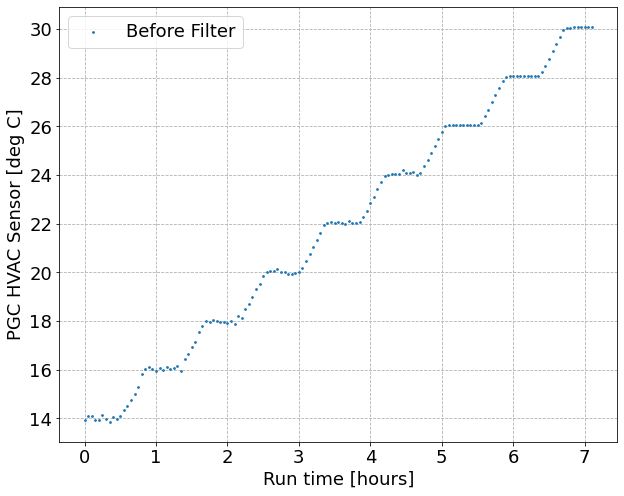

In [268]:
fig, ax = plt.subplots()

h0 = df_temp_r.hours_delta.min()

ax.scatter(df_temp_r.hours_delta - h0, df_temp_r['Parameter HVAC sensor'], s=3, label='Before Filter')
# ax.scatter(df_temp_d.hours_delta - h0, df_temp_d['Parameter HVAC sensor'], s=3, label='After Filter')

ax.set_xlabel('Run time [hours]')
ax.set_ylabel('PGC HVAC Sensor [deg C]')

ax.legend();

In [269]:
Temp_r = ramp_Temps[i]

In [270]:
Temp_r

array([14, 16, 18, 20, 22, 24, 26, 28, 30])

In [271]:
buffer_minutes = 1.
queries = []
for T in Temp_r:
    df_p = df_pgc_r.query(f'`Air Set Point` == {T}').copy()
    t0_p = df_p.index.min() + timedelta(minutes=buffer_minutes)
    # kludge for PGC off
    tf_p = t0_p + timedelta(minutes=30-buffer_minutes)
    #tf_p = df_p.index.max() - timedelta(minutes=buffer_minutes)
    queries.append(f'("{t0_p}" <= Datetime <= "{tf_p}")')
query_str = " or ".join(queries)

df_d = df_r.query(query_str, engine='python').copy()
df_temp_d = df_temp_r.query(query_str, engine='python').copy()
df_pgc_d = df_pgc_r.query(query_str, engine='python').copy()

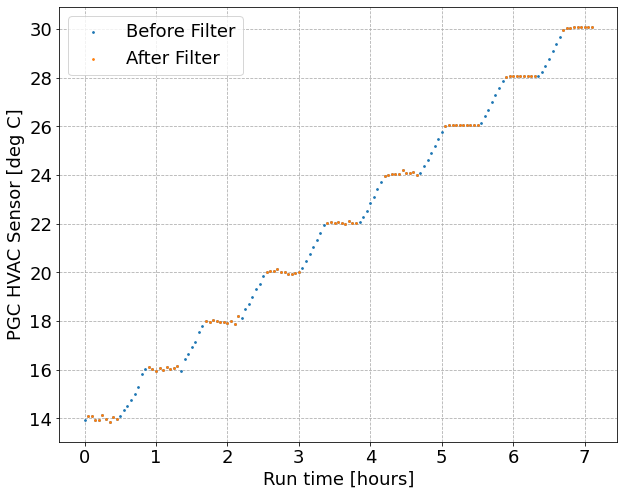

In [272]:
fig, ax = plt.subplots()

h0 = df_temp_r.hours_delta.min()

ax.scatter(df_temp_r.hours_delta - h0, df_temp_r['Parameter HVAC sensor'], s=3, label='Before Filter')
ax.scatter(df_temp_d.hours_delta - h0, df_temp_d['Parameter HVAC sensor'], s=3, label='After Filter')

ax.set_xlabel('Run time [hours]')
ax.set_ylabel('PGC HVAC Sensor [deg C]')

ax.legend();

- Combine filter for all measurements

In [273]:
dfs = []
dfs_temp = []
dfs_pgc = []

for i in range(len(t0s)):
    df_pgc_r = df_pgc.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    #df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    df_r = df_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    # add run number
    df_pgc_r['step'] = i
    df_r['step'] = i
    df_temp_r['step'] = i

    Temp_r = ramp_Temps[i]

    buffer_minutes = 1.
    queries = []
    for T in Temp_r:
        df_p = df_pgc_r.query(f'`Air Set Point` == {T}').copy()
        t0_p = df_p.index.min() + timedelta(minutes=buffer_minutes)
        # kludge for PGC off
        tf_p = t0_p + timedelta(minutes=30-buffer_minutes)
#         tf_p = df_p.index.max() - timedelta(minutes=buffer_minutes)
        queries.append(f'("{t0_p}" <= Datetime <= "{tf_p}")')
    query_str = " or ".join(queries)

    df_d = df_r.query(query_str, engine='python').copy()
    df_temp_d = df_temp_r.query(query_str, engine='python').copy()
    df_pgc_d = df_pgc_r.query(query_str, engine='python').copy()
    ## append dataframe lists
    dfs.append(df_d)
    dfs_temp.append(df_temp_d)
    dfs_pgc.append(df_pgc_d)

df_clean = pd.concat(dfs, ignore_index=False)
df_temp_clean = pd.concat(dfs_temp, ignore_index=False)
df_pgc_clean = pd.concat(dfs_pgc, ignore_index=False)

In [274]:
df_clean

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Bmag,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-07-25 09:22:07,7/25/2021 9:22:07 AM,124.836157,15.179502,0.717460,0.0,114944.0,-148287.0,-1985446.0,18044.0,0.714904,...,1.994291e+06,3.047375,-0.911395,0.717734,1.610374,-0.079550,0.121595,0.243191,1894.950648,0
2021-07-25 09:22:34,7/25/2021 9:22:34 AM,124.836327,15.179518,0.717459,0.0,114950.0,-148465.0,-1985578.0,18037.0,0.714950,...,1.994436e+06,3.047309,-0.911951,0.717785,1.610370,-0.079634,0.121595,0.243191,1894.955309,0
2021-07-25 09:22:53,7/25/2021 9:22:53 AM,124.836327,15.179538,0.717460,0.0,115074.0,-148377.0,-1985514.0,18013.0,0.714921,...,1.994373e+06,3.047303,-0.911142,0.717755,1.610436,-0.079593,0.121596,0.243191,1894.957806,0
2021-07-25 09:23:12,7/25/2021 9:23:12 AM,124.836157,15.179578,0.717460,0.0,115054.0,-148411.0,-1985527.0,18009.0,0.714924,...,1.994387e+06,3.047296,-0.911337,0.717759,1.610425,-0.079609,0.121596,0.243192,1894.960219,0
2021-07-25 09:23:31,7/25/2021 9:23:31 AM,124.836383,15.179602,0.717461,0.0,114979.0,-148340.0,-1985482.0,18004.0,0.714907,...,1.994333e+06,3.047345,-0.911421,0.717739,1.610389,-0.079575,0.121596,0.243192,1894.966573,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-13 07:33:41,8/13/2021 7:33:41 AM,41.612249,4.941655,0.245699,0.0,-17110.0,-20230.0,-673433.0,37249.0,0.245366,...,6.739540e+05,3.102269,-2.272832,0.245767,1.526872,-0.036517,0.118755,0.237510,205.633377,16
2021-08-13 07:34:38,8/13/2021 7:34:38 AM,41.612334,4.941662,0.245698,0.0,-17052.0,-20198.0,-673541.0,37253.0,0.245406,...,6.740595e+05,3.102367,-2.271938,0.245805,1.526966,-0.036465,0.118755,0.237509,205.634074,16
2021-08-13 07:35:18,8/13/2021 7:35:18 AM,41.612215,4.941735,0.245698,0.0,-17122.0,-20296.0,-673494.0,37279.0,0.245391,...,6.740173e+05,3.102187,-2.271572,0.245793,1.526854,-0.036613,0.118757,0.237514,205.636538,16


In [275]:
df_clean.step

Datetime
2021-07-25 09:22:07     0
2021-07-25 09:22:34     0
2021-07-25 09:22:53     0
2021-07-25 09:23:12     0
2021-07-25 09:23:31     0
                       ..
2021-08-13 07:33:41    16
2021-08-13 07:34:38    16
2021-08-13 07:35:18    16
2021-08-13 07:35:57    16
2021-08-13 07:36:35    16
Name: step, Length: 12397, dtype: int64

In [276]:
len(df_), len(df_clean)

(66199, 12397)

In [281]:
#fig = scatter2d([df_.index, df_temp_.index], [df_[f'{probe}_Cal_T'], df_temp_['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [280]:
#fig = scatter2d([df_clean.index, df_temp_clean.index], [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [279]:
#fig = scatter2d([df_clean.index, df_temp_clean.index, df_pgc_clean.index],
#                [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor'], df_pgc_clean['Air Set Point']],
#                markers=True, size_list=3*[5], lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [282]:
#fig = scatter2d([df_clean.index, df_temp_clean.index, df_pgc_clean.index, df_temp_clean.index],
#                [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor'], df_pgc_clean['Air Set Point'], df_temp_clean['Yoke (center magnet)'],],
#                markers=True, size_list=4*[3], lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

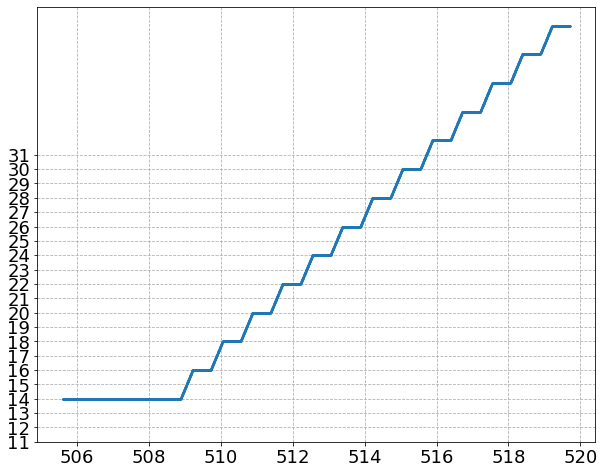

In [283]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

# ax.plot(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values)
# plt.locator_params(axis='y', nbins=6)
# ax.x

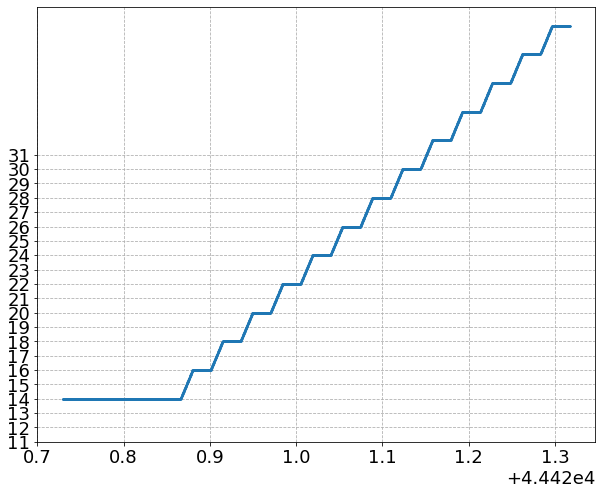

In [284]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_r['Time Float'].values, df_pgc_r['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

# ax.plot(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values)
# plt.locator_params(axis='y', nbins=6)
# ax.x

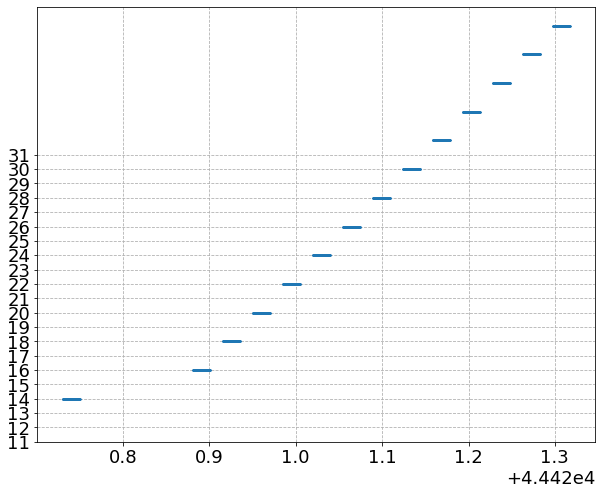

In [285]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_d['Time Float'].values, df_pgc_d['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

In [286]:
# NO FILTERING
#query_string = ' or '.join([f'("{t0_}" <= Datetime <= "{tf_}")' for t0_, tf_ in zip(t0s, tfs)])
#df_run = df_.query(query_string).copy()
# FILTERED
df_run = df_clean.copy()

In [287]:
# NO FILTERING, for validation
# query_string = ' or '.join([f'("{t0_}" <= Datetime <= "{tf_}")' for t0_, tf_ in zip(t0s, tfs)])
# df_run_full = df_.query(query_string).copy()

In [288]:
t0

'2021-07-25 09:15'

In [289]:
# Multiple ramps before fit data, some fast, some slow, for validation
query_string = f'(Datetime <= "{t0}") and (`NMR [T]` > 0.68)' 
df_run_full = df.query(query_string).copy()

In [290]:
len(df_run_full)

16611

In [291]:
df_run

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Bmag,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-07-25 09:22:07,7/25/2021 9:22:07 AM,124.836157,15.179502,0.717460,0.0,114944.0,-148287.0,-1985446.0,18044.0,0.714904,...,1.994291e+06,3.047375,-0.911395,0.717734,1.610374,-0.079550,0.121595,0.243191,1894.950648,0
2021-07-25 09:22:34,7/25/2021 9:22:34 AM,124.836327,15.179518,0.717459,0.0,114950.0,-148465.0,-1985578.0,18037.0,0.714950,...,1.994436e+06,3.047309,-0.911951,0.717785,1.610370,-0.079634,0.121595,0.243191,1894.955309,0
2021-07-25 09:22:53,7/25/2021 9:22:53 AM,124.836327,15.179538,0.717460,0.0,115074.0,-148377.0,-1985514.0,18013.0,0.714921,...,1.994373e+06,3.047303,-0.911142,0.717755,1.610436,-0.079593,0.121596,0.243191,1894.957806,0
2021-07-25 09:23:12,7/25/2021 9:23:12 AM,124.836157,15.179578,0.717460,0.0,115054.0,-148411.0,-1985527.0,18009.0,0.714924,...,1.994387e+06,3.047296,-0.911337,0.717759,1.610425,-0.079609,0.121596,0.243192,1894.960219,0
2021-07-25 09:23:31,7/25/2021 9:23:31 AM,124.836383,15.179602,0.717461,0.0,114979.0,-148340.0,-1985482.0,18004.0,0.714907,...,1.994333e+06,3.047345,-0.911421,0.717739,1.610389,-0.079575,0.121596,0.243192,1894.966573,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-13 07:33:41,8/13/2021 7:33:41 AM,41.612249,4.941655,0.245699,0.0,-17110.0,-20230.0,-673433.0,37249.0,0.245366,...,6.739540e+05,3.102269,-2.272832,0.245767,1.526872,-0.036517,0.118755,0.237510,205.633377,16
2021-08-13 07:34:38,8/13/2021 7:34:38 AM,41.612334,4.941662,0.245698,0.0,-17052.0,-20198.0,-673541.0,37253.0,0.245406,...,6.740595e+05,3.102367,-2.271938,0.245805,1.526966,-0.036465,0.118755,0.237509,205.634074,16
2021-08-13 07:35:18,8/13/2021 7:35:18 AM,41.612215,4.941735,0.245698,0.0,-17122.0,-20296.0,-673494.0,37279.0,0.245391,...,6.740173e+05,3.102187,-2.271572,0.245793,1.526854,-0.036613,0.118757,0.237514,205.636538,16


In [292]:
len(df), len(df_), len(df_run)

(111762, 66199, 12397)

In [293]:
plotdir

'/home/ckampa/data/hallprobecalib_extras/plots/hall_probe_B_T/08-05-21_15:30/'

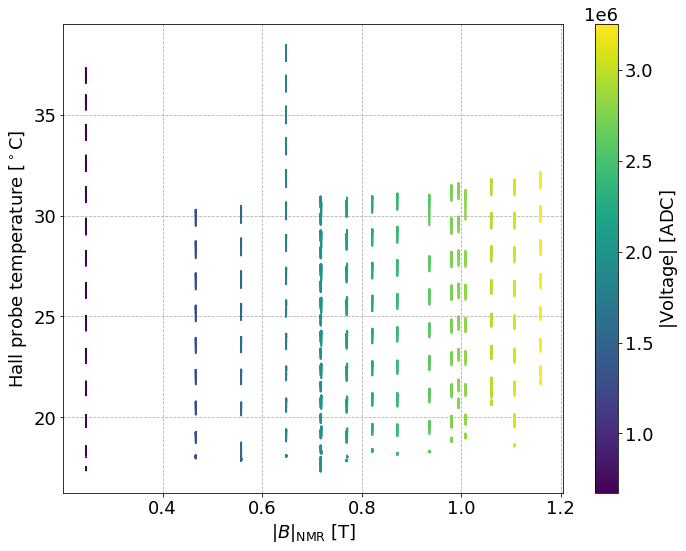

In [294]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')

sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], c=df_run[f'{probe}_Raw_Bmag'], s=1)
cb = fig.colorbar(sc, label=r'$|\mathrm{Voltage}|$ [ADC]')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'V_vs_T_B.png')
fig.savefig(plotdir+'V_vs_T_B.pdf')

In [296]:
fig = scatter3d(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], df_run[f'{probe}_Raw_Bmag'], inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

## Initial Combined Fit

### Simple Polynomial

In [297]:
df_run[[f'{probe}_Cal_T', 'NMR [T]']].describe()

,2F0000000D5EC73A_Cal_T,NMR [T]
count,12397.000000,12397.000000
mean,24.663404,0.833448
std,4.458118,0.221127
min,17.315000,0.245697
25%,20.933000,0.717484
50%,24.358000,0.821129
75%,28.143000,0.994623
max,38.460000,1.159252


In [298]:
T0 = 24.0
B0 = 0.96

# T0 = 23.99
# B0 = 0.805

def model_quad_B_T(B, T, **params):
    return params['C_0'] + params['B_1'] * (B-B0) + params['B_2'] * (B-B0)**2 + params['B_3'] * (B-B0)**3 \
         + params['T_1'] * (T-T0) + params['T_2'] * (T-T0)**2 + params['T_3'] * (T-T0)**3

In [299]:
#coord = 'Z'

In [300]:
#std_V = 600 # 2e-4, microvolts
###std_V = 90 # 3e-5, microvolts
# magnitude
std_V = 3e-5 * df_run[f'{probe}_Raw_Bmag'] # 3e-5, microvolts
# one component
#std_V = 3e-5 * df_run[f'{probe}_Raw_{coord}'] # 3e-5, microvolts

#std_V = 160 # 5.2e-5, microvolts

# std_B = 1e-4
std_B = 3e-5 * df_run[f'{probe}_Cal_Bmag']
std_T = 0.0006 * df_run[f'{probe}_Cal_T'] # same as used in magnet ramp, but check for Hall probe temp probes! FIXME!

In [301]:
std_V

Datetime
2021-07-25 09:22:07    59.828733
2021-07-25 09:22:34    59.833083
2021-07-25 09:22:53    59.831190
2021-07-25 09:23:12    59.831619
2021-07-25 09:23:31    59.829987
                         ...    
2021-08-13 07:33:41    20.218620
2021-08-13 07:34:38    20.221785
2021-08-13 07:35:18    20.220518
2021-08-13 07:35:57    20.215986
2021-08-13 07:36:35    20.216311
Name: 2F0000000D5EC73A_Raw_Bmag, Length: 12397, dtype: float64

In [302]:
model = lm.Model(model_quad_B_T, independent_vars=['B', 'T'])
params = lm.Parameters()
params.add('C_0', value=0, vary=True)
params.add('B_1', value=0, vary=True)
params.add('B_2', value=0, vary=True)
# params.add('B_2', value=0, vary=False)
params.add('B_3', value=0, vary=False)
params.add('T_1', value=0, vary=True)
params.add('T_2', value=0, vary=False)
params.add('T_3', value=0, vary=False)
# magnitude
results = model.fit(df_run[f'{probe}_Raw_Bmag'].values, B=df_run['NMR [T]'].values,
                    T=df_run[f'{probe}_Cal_T'].values, params=params,
                    weights= 1./std_V)
                    #weights= np.ones_like(df_run[f'{probe}_Cal_Bmag'])/std_V)
# one component
# results = model.fit(df_run[f'{probe}_Raw_{coord}'].values, B=df_run['NMR [T]'].values,
#                     T=df_run[f'{probe}_Cal_T'].values, params=params,
#                     weights= 1./std_V)
#                     #weights= np.ones_like(df_run[f'{probe}_Cal_Bmag'])/std_V)

In [303]:
results

In [304]:
results.plot()

Fit can only be plotted if the model function has one independent variable.


False

In [305]:
res = results.best_fit - results.data
res_pd = pd.Series(res, name='Residuals [micro V]')
res_rel = (results.best_fit - results.data) / results.data
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

In [306]:
# fig.patch.set_facecolor('white')
# fig.tight_layout()
# fig.savefig(plotdir+'V_vs_T_B.png')
# fig.savefig(plotdir+'V_vs_T_B.pdf')

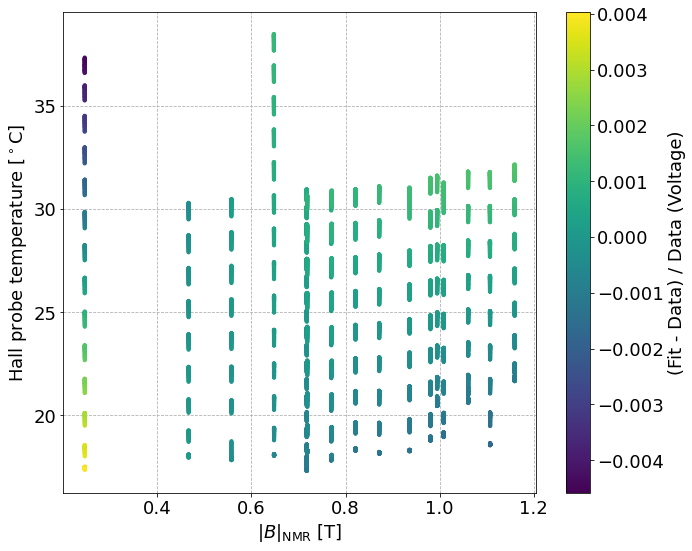

In [307]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data (Voltage)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'simple_fit_res_vs_T_B.png')
fig.savefig(plotdir+'simple_fit_res_vs_T_B.pdf')

In [308]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [309]:
fig = histo(res_rel_pd, bins=100, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 160], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 160], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)

### Chebyshev

In [310]:
# altered from simulation / fitting studies September 2020
# but removed theta & phi dependence
def V_forward(Bs, ts, **params):
    '''
    Parameters: 
    length-N numpy.arrays -- Bs (magnetic field), 
    ts (temperature)
    dictionary -- params where key is of form "c_knlm"
    and value is a float. Also needs "Bmin, Bmax, tmin, tmax" for scaling Chebyshev polynomial inputs
    
    Return: V (Hall voltage), a length-N numpy.array
    '''
#     params_ = deepcopy(dict(params)) # wrap with dict for use in lmfit
    params_ = params
    # normalizations
    B_sub = (params['Bmax'] + params['Bmin']) / 2
    B_div = (params['Bmax'] - params['Bmin']) / 2
    Bs_scaled = (Bs - B_sub) / B_div
    t_sub = (params['tmax'] + params['tmin']) / 2
    t_div = (params['tmax'] - params['tmin']) / 2
    ts_scaled = (ts - t_sub) / t_div
    # sum limits
    kmax = params['kmax']
    nmax = params['nmax']
    # delete non-sum related parameters
    #[params.pop(key) for key in ['Bmin', 'Bmax', 'tmin', 'tmax', 'kmax', 'nmax', 'lmax', 'theta0', 'phi0']]
    
#     [params.pop(key) for key in ['Bmin', 'Bmax', 'tmin', 'tmax', 'kmax', 'nmax']]
    
    # loop B
#     V = 0.
    V = np.zeros_like(Bs_scaled)
    for k in range(kmax+1):
        coeffs_k = np.zeros(kmax+1)
        coeffs_k[k] = 1.
        T_k = np.polynomial.chebyshev.chebval(Bs_scaled, coeffs_k)
        # loop t
        for n in range(nmax+1):
            c_kn = params[f'c_{k}{n}']
            coeffs_n = np.zeros(nmax+1)
            coeffs_n[n] = 1.
            T_n = np.polynomial.chebyshev.chebval(ts_scaled, coeffs_n)
            V += c_kn * T_k * T_n 
    
    return V

In [311]:
# looking at a single component
# THETA0 = df_[f'{probe}_Raw_Theta'].mean() - np.pi # CHECK PHASE
THETA0 = 0. # cos(0) = 1. use for magnitude
#
# Bcomp = 'Z'
Bcomp = 'Bmag' # magnitude

In [312]:
#std_V = 600 # 2e-4, microvolts
###std_V = 90 # 3e-5, microvolts
# magnitude
std_V = 3e-5 * df_run[f'{probe}_Raw_{Bcomp}'] # 3e-5, microvolts, component
# std_V = 3e-5 * df_run[f'{probe}_Raw_Bmag'] # 3e-5, microvolts, magnitude
# one component
#std_V = 3e-5 * df_run[f'{probe}_Raw_{coord}'] # 3e-5, microvolts

#std_V = 160 # 5.2e-5, microvolts

# std_B = 1e-4
std_B = 3e-5 * df_run[f'{probe}_Cal_{Bcomp}']
# std_B = 3e-5 * df_run[f'{probe}_Cal_Bmag']
std_T = 0.0006 * df_run[f'{probe}_Cal_T'] # same as used in magnet ramp, but check for Hall probe temp probes! FIXME!

In [313]:
df_run.eval(f'B_scaled = cos({THETA0}) * `NMR [T]`', inplace=True)
df_run_full.eval(f'B_scaled = cos({THETA0}) * `NMR [T]`', inplace=True)

In [314]:
THETA0

0.0

In [315]:
df_run[[f'{probe}_Cal_T', 'NMR [T]', 'B_scaled']].describe()

,2F0000000D5EC73A_Cal_T,NMR [T],B_scaled
count,12397.000000,12397.000000,12397.000000
mean,24.663404,0.833448,0.833448
std,4.458118,0.221127,0.221127
min,17.315000,0.245697,0.245697
25%,20.933000,0.717484,0.717484
50%,24.358000,0.821129,0.821129
75%,28.143000,0.994623,0.994623
max,38.460000,1.159252,1.159252


In [316]:
#Bmin = 0.71 # T
Bmin = 0.24 # T
# Bmax = 1.11 # T
Bmax = 1.16 # T
tmin = 17.3 # deg C
#tmax = 32.2 # deg C
tmax = 40. # deg C, high temp test

In [317]:
# full range test
# Bmin = 0. # T
# Bmax = 2.25 # T
# tmin = 17.3 # deg C
# #tmax = 31.8 # deg C
# tmax = 40. # deg C, high temp test

In [318]:
Bmin, Bmax, tmin, tmax

(0.24, 1.16, 17.3, 40.0)

In [319]:
# from Bergsma
kmax = 5
nmax = 2

In [320]:
# testing poor fits
# kmax = 1
# nmax = 0

In [321]:
kmax, nmax

(5, 2)

In [322]:
# construct model
model = lm.Model(V_forward, independent_vars=['Bs', 'ts'])
params = lm.Parameters()
for k in range(kmax+1):
    for n in range(nmax+1):
        params.add(f'c_{k}{n}', value=0)
params.add('Bmin', value=Bmin, vary=False)
params.add('Bmax', value=Bmax, vary=False)
params.add('tmin', value=tmin, vary=False)
params.add('tmax', value=tmax, vary=False)
params.add('kmax', value=kmax, vary=False)
params.add('nmax', value=nmax, vary=False)

In [323]:
V_forward(Bs=df_run['B_scaled'].values,
          ts=df_run[f'{probe}_Cal_T'].values,
          **params)

array([0., 0., 0., ..., 0., 0., 0.])

In [324]:
len(std_V), len(df_run)

(12397, 12397)

In [325]:
%%time
# fit!
# old
# result = model.fit(df_run[f'{probe}_Raw_Bmag'].values, Bs=df_run['NMR [T]'].values, ts=df_run[f'{probe}_Cal_T'].values,
#                    params=params, weights= 1/std_V.values, method='leastsq')#_squares')
# include component
result = model.fit(df_run[f'{probe}_Raw_{Bcomp}'].values, Bs=df_run['B_scaled'].values, ts=df_run[f'{probe}_Cal_T'].values,
                   params=params, weights= 1/std_V.values, method='leastsq')#_squares')

CPU times: user 440 ms, sys: 4.17 ms, total: 444 ms
Wall time: 393 ms


In [326]:
# partial most recent run
# Bz
result

In [327]:
result.plot()

Fit can only be plotted if the model function has one independent variable.


False

In [328]:
Bmax, Bmin

(1.16, 0.24)

In [329]:
tmin, tmax

(17.3, 40.0)

In [330]:
V_forward(Bmin, tmin, **result.params)

array(662843.07648127)

In [331]:
V_forward(Bmax, tmin, **result.params)

array(3260996.51592875)

In [332]:
V_forward(1., tmin, **result.params)

array(2799168.75000148)

In [333]:
V_forward(1., 12., **result.params)

array(2805760.15623076)

In [334]:
V_forward(1., tmax, **result.params)

array(2773945.01718633)

In [335]:
res = result.best_fit - result.data
# res_pd = pd.Series(res, name='Residuals [micro V]')
res_pd = pd.Series(res, name='Residuals [ADC]')
res_rel = (result.best_fit - result.data) / result.data
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

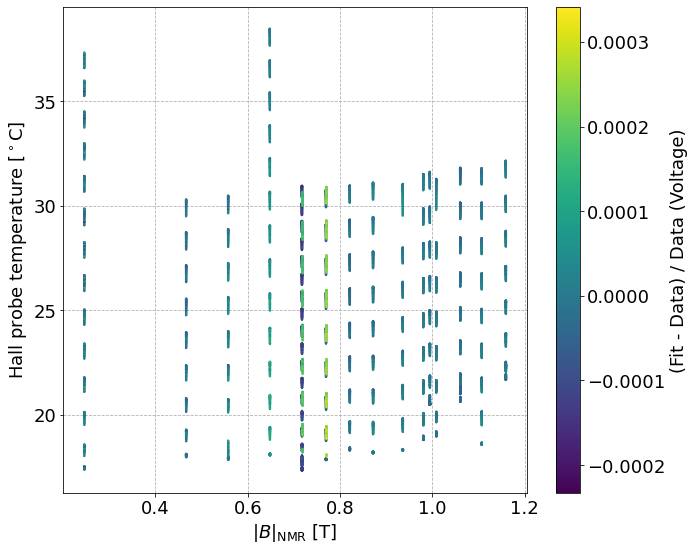

In [336]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=2, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data (Voltage)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'cheb_fit_vs_T_B.png')
fig.savefig(plotdir+'cheb_fit_vs_T_B.pdf')

In [252]:
# fig = scatter3d(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig = scatter3d(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'voltage_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'voltage_residual_vs_B_T_plotly.pdf')
fig

In [253]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [254]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'voltage_residual_histo.png')
fig.write_image(plotdir+'voltage_residual_histo.pdf')
fig

In [255]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
fig.update_yaxes(type='log')
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'voltage_residual_histo_log.png')
fig.write_image(plotdir+'voltage_residual_histo_log.pdf')
fig

In [256]:
df_run.tail()

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step,B_scaled
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-03 01:50:33,8/3/2021 1:50:33 AM,224.06238,29.181267,1.158962,0.0,184058.0,-239500.0,-3223452.0,32122.0,1.154667,...,3.048160,-0.915554,1.159192,1.610219,-0.079125,0.130237,0.260474,6538.424061,10,1.158962
2021-08-03 01:50:52,8/3/2021 1:50:52 AM,224.06238,29.181350,1.158962,0.0,183952.0,-239598.0,-3223481.0,32136.0,1.154684,...,3.048157,-0.916030,1.159210,1.610184,-0.079155,0.130238,0.260475,6538.442733,10,1.158962
2021-08-03 01:51:11,8/3/2021 1:51:11 AM,224.06238,29.181417,1.158961,0.0,183922.0,-239487.0,-3223476.0,32129.0,1.154678,...,3.048189,-0.915885,1.159200,1.610175,-0.079120,0.130238,0.260476,6538.457670,10,1.158961
2021-08-03 01:51:30,8/3/2021 1:51:30 AM,224.06238,29.181433,1.158961,0.0,183951.0,-239523.0,-3223448.0,32140.0,1.154674,...,3.048174,-0.915881,1.159197,1.610185,-0.079133,0.130238,0.260476,6538.461404,10,1.158961
2021-08-03 01:51:50,8/3/2021 1:51:50 AM,224.06238,29.181600,1.158960,0.0,184002.0,-239516.0,-3223341.0,32142.0,1.154638,...,3.048163,-0.915733,1.159162,1.610203,-0.079133,0.130239,0.260477,6538.498748,10,1.158960


# Inverting the Problem
- |V|(|B|, Temp) --> |B|(|V|, Temp)

In [257]:
from scipy.optimize import fsolve

In [258]:
def inv_B(B, V, T, params):
    if not isinstance(B, np.ndarray):
        B = np.array([B])
        V = np.array([V])
        T = np.array([T])
    return [(V_forward(B, T, **params) - V)[0]]

def inv_B_v2(B, V, T, params):
#     if not isinstance(B, np.ndarray):
#         B = np.array([B])
#         V = np.array([V])
#         T = np.array([T])
    return [(V_forward(B, T, **params) - V)[0]]

In [259]:
type(np.array([1.2]))

numpy.ndarray

In [260]:
import collections.abc

In [261]:
collections.abc.Sequence

collections.abc.Sequence

In [262]:
isinstance(np.array([1.2, 0.]), np.ndarray)

True

In [263]:
inv_B(1., 2.795882852e6, 20., result.params)

[53.2941399612464]

In [264]:
inv_B(np.array([1.]), np.array([2.795882852e6]), np.array([20.]), result.params)

[53.2941399612464]

In [265]:
inv_B(np.array([1.+1e-4]), np.array([2.795882852e6]), np.array([20.]), result.params)

[340.00798514438793]

In [266]:
%time root = fsolve(func=inv_B, x0=[0.5], args=(2.795882852e6, 20., result.params))

CPU times: user 2.61 ms, sys: 924 µs, total: 3.53 ms
Wall time: 2.92 ms


In [267]:
%time root = fsolve(func=inv_B_v2, x0=[0.5], args=(2.795882852e6, 20., result.params))

CPU times: user 4.16 ms, sys: 0 ns, total: 4.16 ms
Wall time: 3.6 ms


In [268]:
Bmax

1.16

In [269]:
V_forward(2.24, tmin, **result.params)

array(8760429.33108119)

In [270]:
(Bmin+Bmax)/2

0.9349999999999999

In [271]:
fsolve(func=inv_B_v2, x0=[1.125], args=(-2.2289e6, 20., result.params))

array([-0.32952141])

In [272]:
V_forward(0, 20., **result.params)

array(-270014.01010987)

In [273]:
Bmin

0.71

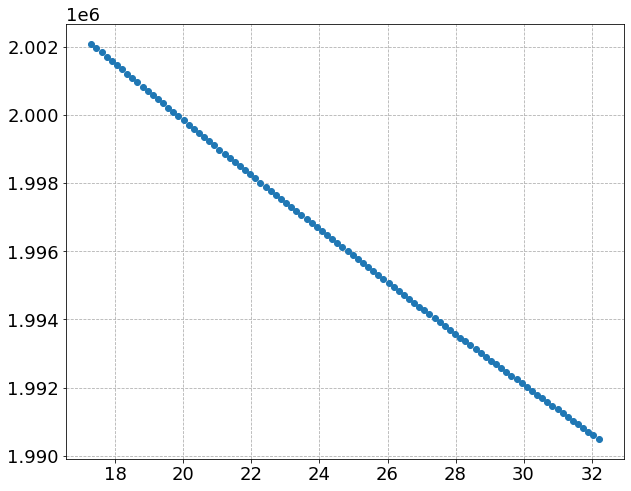

In [274]:
ts = np.linspace(tmin, tmax, 100)
# v0s = np.array([V_forward(0., t, **result.params) for t in ts])
v0s = np.array([V_forward(0.72, t, **result.params) for t in ts])

fig, ax = plt.subplots()
ax.scatter(ts, v0s)

In [275]:
(v0s[-1] - v0s[0]) / (ts[-1] - ts[0])

-777.9333084005074

In [276]:
# FROM MANUFACTURER: Temp. Coeff. of V_H, for B=0.05 T, I_C=5 mA, Ta=25-125 C, max = -0.06 % / deg C
1/v0s[-1] * (v0s[-1] - v0s[0]) / (ts[-1] - ts[0]) * 100

-0.03908242628504798

In [277]:
# looks good

In [278]:
(v0s[-1] - v0s[0]) / (ts[-1] - ts[0]) * 1e-6

-0.0007779333084005074

In [279]:
23e-3 * len(df_run)

213.325

In [280]:
root

array([0.99998141])

In [281]:
root1 = fsolve(func=inv_B, x0=[0.5], args=(2795881., 20., result.params))
root2 = fsolve(func=inv_B, x0=[0.5], args=(2795882., 20., result.params))
root3 = fsolve(func=inv_B, x0=[0.5], args=(2795883., 20., result.params))

In [282]:
root1, root2, root3

(array([0.99998077]), array([0.99998111]), array([0.99998146]))

In [283]:
root2-root1

array([3.48781196e-07])

In [284]:
root3-root2

array([3.48781189e-07])

--> Each ADC value corresponds to ~3.5e-7 Tesla

In [285]:
# SLOW
# B_cals = []
# #for row in df_run.itertuples():
# for i in range(len(df_run.iloc[:1000])):
#     row = df_run.iloc[i]
#     B_ = fsolve(func=inv_B, x0=[0.8], args=(row[f'{probe}_Raw_Bmag'], row[f'{probe}_Cal_T'], result.params))
#     B_cals.append(B_)
# B_cals = np.array(B_cals)
# # df_run['B_fit'] = B_cals

In [286]:
#df_run['B_fit']

In [287]:
# run in parallel

In [288]:
from tqdm.notebook import tqdm
from joblib import Parallel, delayed
import multiprocessing
from sys import stdout

In [289]:
def invert_row(df, index):
    row = df.iloc[index]
    #B_ = fsolve(func=inv_B, x0=[0.8], args=(row[f'{probe}_Raw_Bmag'], row[f'{probe}_Cal_T'], result.params))
    #B_ = fsolve(func=inv_B_v2, x0=[0.8], args=(np.array([row[f'{probe}_Raw_Bmag']]), np.array([row[f'{probe}_Cal_T']]), result.params))
    B_ = fsolve(func=inv_B_v2, x0=[0.8], args=(np.array([row[f'{probe}_Raw_{Bcomp}']]), np.array([row[f'{probe}_Cal_T']]), result.params))
    return B_[0]

In [290]:
i = 3000
invert_row(df_run, i), df_run['NMR [T]'].iloc[i]

(0.8210510536609632, 0.821046102)

In [291]:
# %%prun
# invert_row(df_run, 1234)

In [292]:
num_cpu = multiprocessing.cpu_count()
njs = min([num_cpu, len(df_run)])
# parallel for loop
temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(len(df_run)), file=stdout, desc='Measurement #')))
# temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(100), file=stdout, desc='Measurement #')))
# parse output
B_cals = np.ravel(temp)
df_run['B_fit'] = B_cals

Measurement #:   0%|          | 0/9275 [00:00<?, ?it/s]

In [293]:
num_cpu = multiprocessing.cpu_count()
njs = min([num_cpu, len(df_run_full)])
# parallel for loop
temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run_full, i) for i in tqdm(range(len(df_run_full)), file=stdout, desc='Measurement #')))
# temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(100), file=stdout, desc='Measurement #')))
# parse output
B_cals = np.ravel(temp)
df_run_full['B_fit'] = B_cals

Measurement #:   0%|          | 0/16611 [00:00<?, ?it/s]

In [294]:
B_cals

array([0.71748408, 0.71751061, 0.71746322, ..., 0.71749505, 0.71748508,
       0.71748924])

In [295]:
df_run['B_fit'].describe()

count    9275.000000
mean        0.925498
std         0.144783
min         0.717282
25%         0.769573
50%         0.935946
75%         1.060215
max         1.159291
Name: B_fit, dtype: float64

In [296]:
df_run.eval('(B_fit - `NMR [T]`)/`NMR [T]`').describe()

count    9.275000e+03
mean     1.866038e-09
std      2.524234e-05
min     -1.066568e-04
25%     -1.677627e-05
50%     -2.402426e-07
75%      1.664731e-05
max      9.592751e-05
dtype: float64

In [297]:
df_run_full.eval('(B_fit - `NMR [T]`)/`NMR [T]`').describe()

count    16611.000000
mean         0.000020
std          0.000043
min         -0.000164
25%         -0.000008
50%          0.000015
75%          0.000042
max          0.000196
dtype: float64

In [298]:
df_run.eval('(B_fit - B_scaled)/B_scaled').describe()

count    9.275000e+03
mean     1.866038e-09
std      2.524234e-05
min     -1.066568e-04
25%     -1.677627e-05
50%     -2.402426e-07
75%      1.664731e-05
max      9.592751e-05
dtype: float64

In [299]:
df_run_full.eval('(B_fit - B_scaled)/B_scaled').describe()

count    16611.000000
mean         0.000020
std          0.000043
min         -0.000164
25%         -0.000008
50%          0.000015
75%          0.000042
max          0.000196
dtype: float64

In [300]:
# FIT df

In [353]:
res = df_run['B_fit'] - df_run['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (df_run['B_fit'] - df_run['B_scaled']) / df_run['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Fit - |B|_NMR) / |B|_NMR')

In [354]:
df_run['B_scaled']

Datetime
2021-07-25 09:22:07    0.717460
2021-07-25 09:22:34    0.717459
2021-07-25 09:22:53    0.717460
2021-07-25 09:23:12    0.717460
2021-07-25 09:23:31    0.717461
                         ...   
2021-08-03 01:50:33    1.158962
2021-08-03 01:50:52    1.158962
2021-08-03 01:51:11    1.158961
2021-08-03 01:51:30    1.158961
2021-08-03 01:51:50    1.158960
Name: B_scaled, Length: 9275, dtype: float64

In [355]:
df_run[['B_scaled', 'NMR [T]']].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9275 entries, 2021-07-25 09:22:07 to 2021-08-03 01:51:50
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   B_scaled  9275 non-null   float64
 1   NMR [T]   9275 non-null   float64
dtypes: float64(2)
memory usage: 217.4 KB


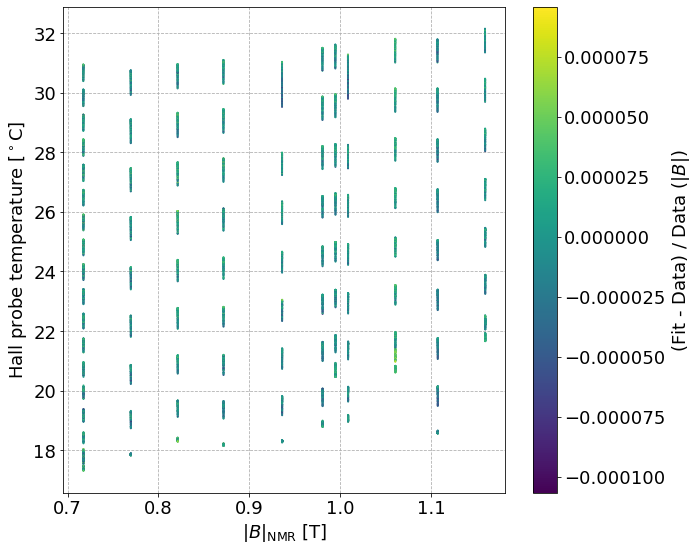

In [356]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'cheb_fit_B_res_vs_T_B.png')
fig.savefig(plotdir+'cheb_fit_B_res_vs_T_B.pdf')

In [357]:
fig = scatter3d(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'B_residual_vs_B_T_plotly.pdf')
fig

In [358]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [359]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'B_residual_histo.png')
fig.write_image(plotdir+'B_residual_histo.pdf')
fig

In [360]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_yaxes(type='log')
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'B_residual_histo_log.png')
fig.write_image(plotdir+'B_residual_histo_log.pdf')
fig

In [361]:
# FULL df

In [362]:
res = df_run_full['B_fit'] - df_run_full['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (df_run_full['B_fit'] - df_run_full['B_scaled']) / df_run_full['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

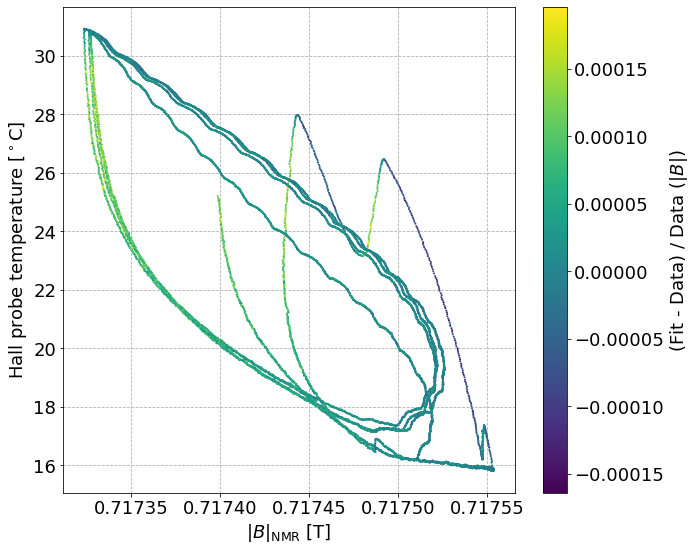

In [363]:
fig, ax = plt.subplots()

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run_full['B_scaled'], df_run_full[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'fast_temp_B_res_vs_T_B.png')
fig.savefig(plotdir+'fast_temp_B_res_vs_T_B.pdf')

In [364]:
fig = scatter3d(df_run_full['B_scaled'], df_run_full[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'fast_temp_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'fast_temp_B_residual_vs_B_T_plotly.pdf')
fig

In [365]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'fast_temp_B_residual_histo.png')
fig.write_image(plotdir+'fast_temp_B_residual_histo.pdf')
fig

In [366]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'fast_temp_B_residual_histo_log.png')
fig.write_image(plotdir+'fast_temp_B_residual_histo_log.pdf')
fig

In [367]:
d = df_run_full[f'{probe}_Cal_T'].diff()/(df_run_full['seconds_delta'].diff() / 60.)

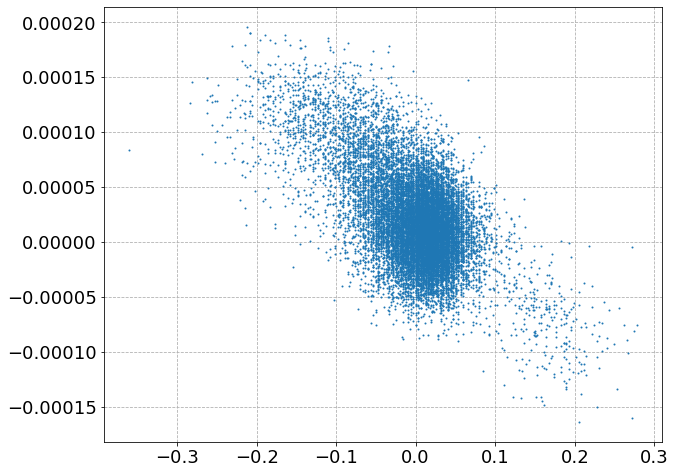

In [368]:
fig, ax = plt.subplots()
ax.scatter(d, res_rel, s=1)

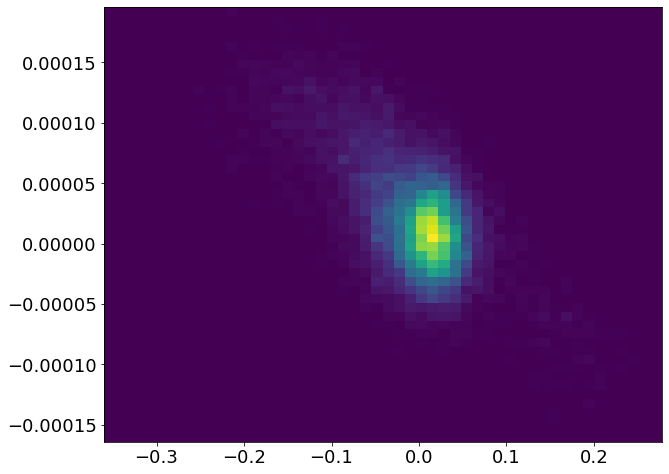

In [369]:
fig, ax = plt.subplots()
ax.hist2d(d[~np.isnan(d)], res_rel[~np.isnan(d)], bins=50);

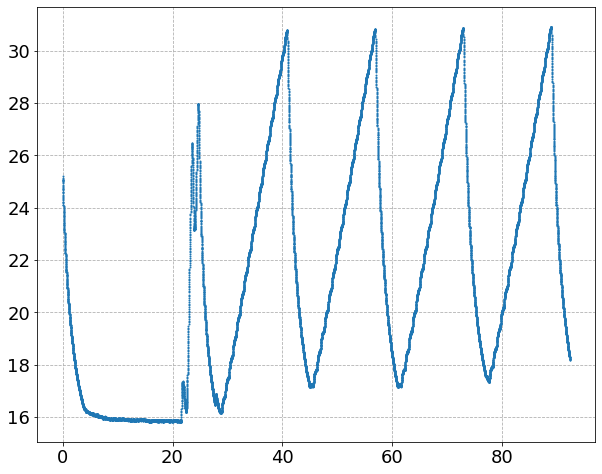

In [370]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'], df_run_full[f'{probe}_Cal_T'], s=1)

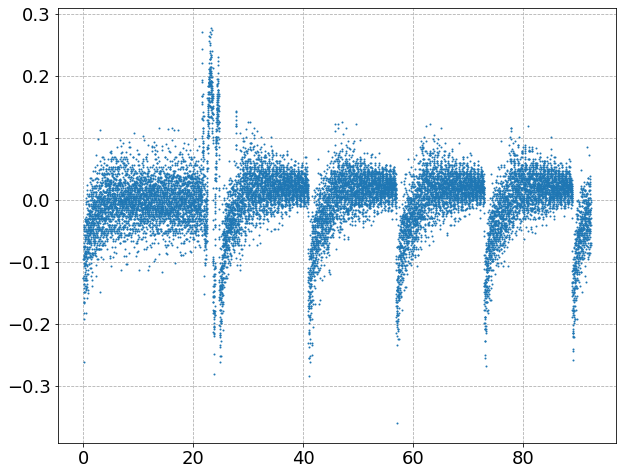

In [371]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'], d, s=1)

In [372]:
# look at only stable temperature
# ensure slow temp changes

In [373]:
#i = np.where(np.isclose(df_run_full['hours_delta'], 29., rtol=1e-3, atol=1e-3))[0][0]
# i = np.where(np.abs(d) <= 0.1)
i = np.where((d <= 0.1) & (d >= -0.02))

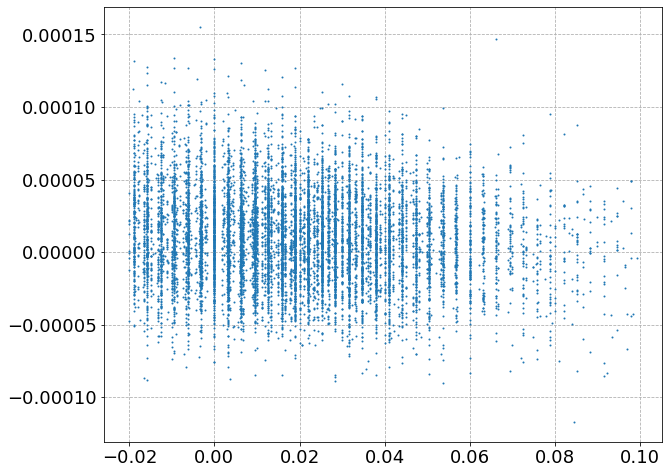

In [374]:
fig, ax = plt.subplots()
# ax.scatter(d[i:], res_rel[i:], s=1)
ax.scatter(d.values[i], res_rel.values[i], s=1)

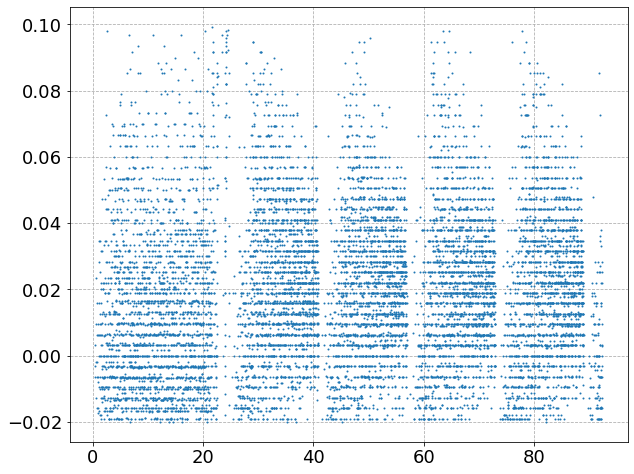

In [375]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'].values[i], d.values[i], s=1)

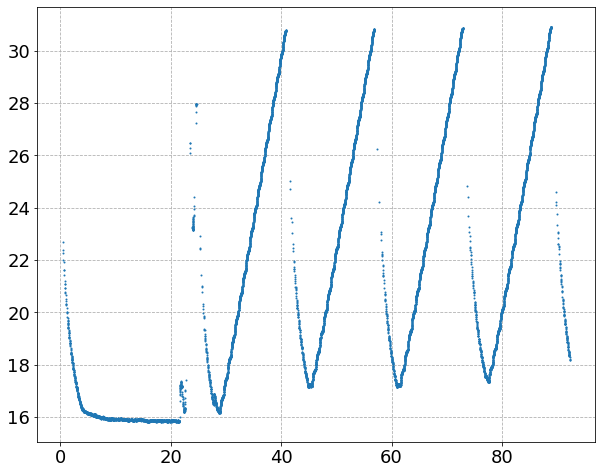

In [376]:
fig, ax = plt.subplots()
# ax.scatter(df_run_full['hours_delta'].iloc[i:], df_run_full[f'{probe}_Cal_T'].iloc[i:], s=1)
ax.scatter(df_run_full['hours_delta'].iloc[i], df_run_full[f'{probe}_Cal_T'].iloc[i], s=1)

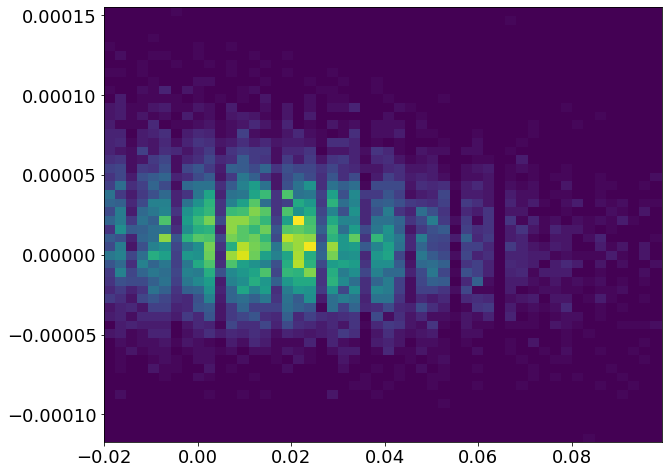

In [377]:
fig, ax = plt.subplots()
# ax.hist2d(d[i:], res_rel[i:], bins=50);
ax.hist2d(d.values[i], res_rel.values[i], bins=50);

In [378]:
res_rel_pd.name

'Relative Residuals'

In [379]:
_ = pd.Series(res_rel_pd.values[i], name='Relative Residuals')
fig = histo(_, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])

In [380]:
## Check Bergsma calibration on fit dataset

In [381]:
# FIT df

In [400]:
df_run_ = df_run.copy()
# df_run_ = df_run.query(f'`{probe}_Cal_T` >= 20.').copy()

In [401]:
df_run_[f'{probe}_Cal_T'].describe()

count    9275.000000
mean       24.415876
std         4.050539
min        17.315000
25%        21.053000
50%        24.235000
75%        27.880000
max        32.142000
Name: 2F0000000D5EC73A_Cal_T, dtype: float64

In [402]:
# original
# res = df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']
# res_pd = pd.Series(res, name='Residuals [T]')
# res_rel = (df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']) / df_run_['NMR [T]']
# res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR')

In [403]:
# key: "Bcomp" (raw), value: [meaning in Bergsma cal, scaling in Bergsma cal (+-1)
Bergsma_dict = {'Bmag':['Bmag', 1.], 'X': ['Z', -1.], 'Y': ['Y', 1.], 'Z': ['X', 1.]} # from my phase addition
# Bergsma_dict = {'Bmag':['Bmag', 1.], 'X': ['Z', -1.], 'Y': ['Y', 1.], 'Z': ['X', -1.]} # from Raw voltage

In [404]:
df_run_[f'{probe}_Cal_X']

Datetime
2021-07-25 09:22:07    0.714904
2021-07-25 09:22:34    0.714950
2021-07-25 09:22:53    0.714921
2021-07-25 09:23:12    0.714924
2021-07-25 09:23:31    0.714907
                         ...   
2021-08-03 01:50:33    1.154667
2021-08-03 01:50:52    1.154684
2021-08-03 01:51:11    1.154678
2021-08-03 01:51:30    1.154674
2021-08-03 01:51:50    1.154638
Name: 2F0000000D5EC73A_Cal_X, Length: 9275, dtype: float64

In [405]:
comp_bergsma = Bergsma_dict[Bcomp][0]
sf = Bergsma_dict[Bcomp][1]
res = sf*df_run_[f'{probe}_Cal_{comp_bergsma}'] - df_run_['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (sf*df_run_[f'{probe}_Cal_{comp_bergsma}'] - df_run_['B_scaled']) / df_run_['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR')

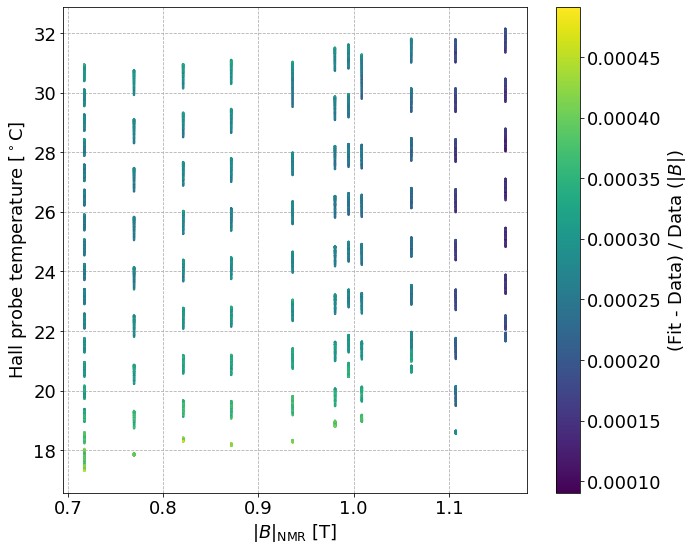

In [406]:
fig, ax = plt.subplots()

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], s=2, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'Bergsma_B_res_vs_T_B.png')
fig.savefig(plotdir+'Bergsma_B_res_vs_T_B.pdf')

In [407]:
fig = scatter3d(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'Bergsma_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'Bergsma_B_residual_vs_B_T_plotly.pdf')
fig

In [408]:
# fig = scatter3d(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
# fig.update_layout(height=700, width=1000)
# plot(fig)

In [409]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [410]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +5.25e-4])
fig.write_image(plotdir+'Bergsma_B_residual_histo.png')
fig.write_image(plotdir+'Bergsma_B_residual_histo.pdf')
fig

In [411]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +5.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'Bergsma_B_residual_histo_log.png')
fig.write_image(plotdir+'Bergsma_B_residual_histo_log.pdf')
fig

# Plots for FMS

In [420]:
probe

'2F0000000D5EC73A'

In [412]:
# combine my calibration with Bergsma calibration

In [413]:
# FIT df

In [414]:
# my fit
res = df_run['B_fit'] - df_run['NMR [T]']
res_pd = pd.Series(res, name='Residuals [T] (Kampa)')
res_rel = (df_run['B_fit'] - df_run['NMR [T]']) / df_run['NMR [T]']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Fit - |B|_NMR) / |B|_NMR (Kampa)')
# bergsma
res_B = df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']
res_pd_B = pd.Series(res_B, name='Residuals [T] (Bergsma)')
res_rel_B = (df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']) / df_run_['NMR [T]']
res_rel_pd_B = pd.Series(res_rel_B, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR (Bergsma)')

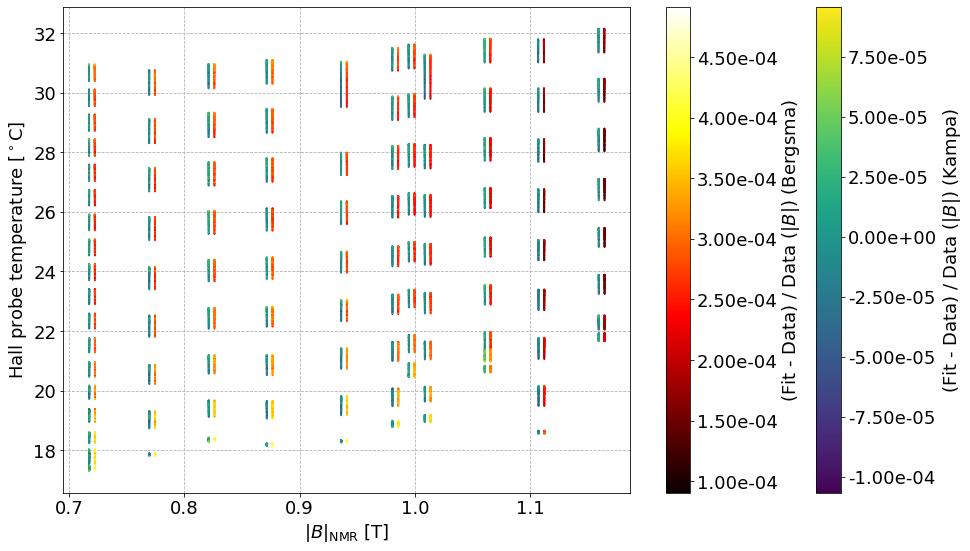

In [415]:
fig, ax = plt.subplots(figsize=(14, 8))

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$) (Kampa)', format='%0.2e')

# SLIGHT OFFSET FOR BERGSMA IN B
sc2 = ax.scatter(df_run['NMR [T]']+5e-3, df_run[f'{probe}_Cal_T'], s=1, c=res_rel_B, cmap='hot')
#cb2 = fig.colorbar(sc2, label=r'(Fit - Data) / Data ($|B|$) (Bergsma)')
cb2 = fig.colorbar(sc2, format='%0.2e')
cb2.set_label(r'(Fit - Data) / Data ($|B|$) (Bergsma)', labelpad=2)

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'both_B_res_vs_T_B.png')
fig.savefig(plotdir+'both_B_res_vs_T_B.pdf')

In [416]:
fig = scatter3d(2*[df_run['NMR [T]']], 2*[df_run[f'{probe}_Cal_T']], [res_rel_pd, res_rel_pd_B],  units_list=2*[('', 'deg C', '')], colors_list=['viridis', 'hot'],
                inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'both_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'both_B_residual_vs_B_T_plotly.pdf')
fig

In [417]:
fig = histo([res_pd, res_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)
fig.update_layout(height=700, width=1000)

In [418]:
fig = histo([res_rel_pd, res_rel_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)

fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
#fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
# fig.update_yaxes(type='log')
fig.write_image(plotdir+'both_B_residual_histo.png')
fig.write_image(plotdir+'both_B_residual_histo.pdf')
fig

In [419]:
fig = histo([res_rel_pd, res_rel_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)

fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
#fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'both_B_residual_histo_log.png')
fig.write_image(plotdir+'both_B_residual_histo_log.pdf')
fig

# Magnet Locations

- Determining offset / where to put Zaber for V vs. B, temp and also for pole-to-pole, for low range NMR taped on top of Zaber

In [483]:
# mm offsets, in magnet coordinates
# delta = low field NMR position - high field NMR position
delta_X = -3.88
delta_Y = 0
delta_Z = 21.01

In [484]:
mm_per_ADC

0.000390625

In [485]:
ADC_per_mm

2560.0

In [487]:
-delta_X * ADC_per_mm

9932.8

- Cannot actually put x closer, so just calculate new Y, Z
- Y is not offset so only Z

In [488]:
delta_Z * ADC_per_mm

53785.600000000006

- Add this number to Z ADC (since Z increases ADC as it goes towards the floor)

In [494]:
X_hi = 463412 # by hand limit from before low field NMR was installed
X_lo = 459413 # by hand put limit
Y_hi = 424673
Y_lo = Y_hi
Z_hi = 1675120
Z_lo = Z_hi + delta_Z * ADC_per_mm

In [495]:
Z_lo

1728905.6

In [497]:
(Z_lo - 1710750) * mm_per_ADC

7.092031250000037

In [491]:
(X_lo-X_hi) * mm_per_ADC

-1.5621093750000001

In [492]:
delta_X

-3.88

In [493]:
(X_lo-X_hi) * mm_per_ADC + delta_X

-5.442109375

In [ ]:
new_Z

In [499]:
delta_Z * ADC_per_mm

53785.600000000006

In [500]:
delta_Z

21.01

In [501]:
# pole to pole
1649035 + delta_Z * ADC_per_mm

1702820.6

In [504]:
delta_X

-3.88

In [503]:
delta_X * ADC_per_mm

-9932.8

In [505]:
422190-delta_X * ADC_per_mm

432122.8

In [506]:
delta_X * ADC_per_mm

-9932.8

# Checking Location
- order 4 polynomial in excel spreadsheet for pole-to-pole 420k
- find X (ADC) @ minimum for each. distance apart should give a good idea of any X offset

In [ ]:
# low
# y = -3.043609E-24x4 + 6.007228E-18x3 - 4.402498E-12x2 + 1.419257E-06x + 6.010490E-01
# high
#y = -2.401689E-24x4 + 4.732538E-18x3 - 3.457484E-12x2 + 1.109276E-06x + 6.389832E-01

In [510]:
coeffs_low = np.array([6.010490E-01, 1.419257E-06, -4.402498E-12, 6.007228E-18, -3.043609E-24])[::-1]
coeffs_high = np.array([6.389832E-01, 1.109276E-06, -3.457484E-12, 4.732538E-18, -2.401689E-24])[::-1]
poly_low = np.poly1d(coeffs_low)
poly_high = np.poly1d(coeffs_high)

In [517]:
xs = np.arange(420000, 545000, 1)
ys_low = poly_low(xs)
ys_high = poly_high(xs)

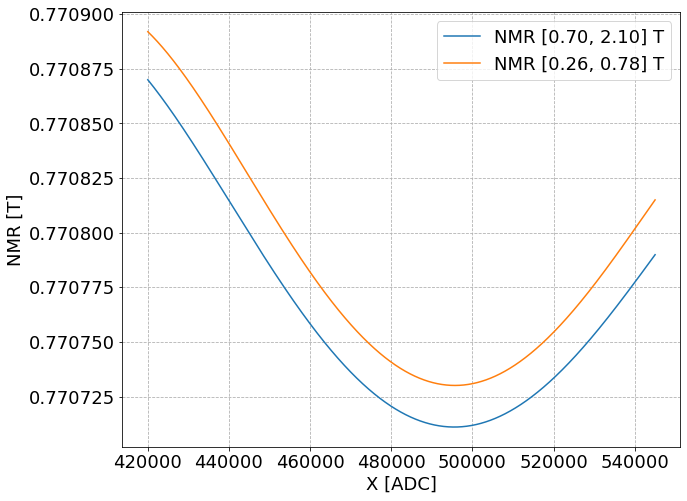

In [520]:
fig, ax = plt.subplots()
ax.plot(xs, ys_high, label='NMR [0.70, 2.10] T')
ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR [T]')
ax.legend();

In [515]:
poly_low(440000)-poly_high(440000)

2.6144716800069467e-05

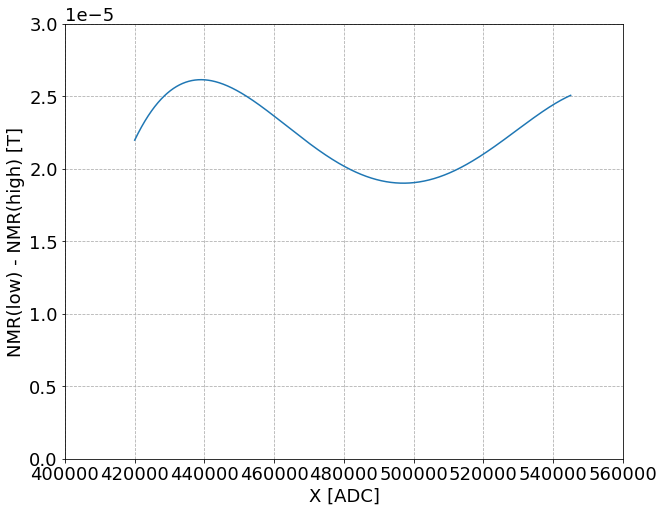

In [523]:
fig, ax = plt.subplots()
ax.plot(xs, ys_low-ys_high)#, label='NMR [0.70, 2.10] T')
# ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR(low) - NMR(high) [T]')
ax.set_xlim([400000, 560000])
ax.set_ylim([0, 3e-5]);
# ax.legend();

In [525]:
x0_low = xs[ys_low.argmin()]
x0_high = xs[ys_high.argmin()]

In [526]:
x0_low - x0_high

149

In [527]:
(x0_low - x0_high) * mm_per_ADC

0.058203125

In [528]:
xs[ys_low.argmin()]

495668

In [530]:
ADC_to_mm(xs[ys_low.argmin()], 'X')

39.60234375

In [531]:
ADC_to_mm(xs[ys_low.argmin()], 'X') * 2

79.2046875

In [532]:
# try correcting and look at the residuals

In [537]:
xs = np.arange(420000, 545000, 1)
ys_low = poly_low(xs-(x0_low - x0_high))
ys_high = poly_high(xs)

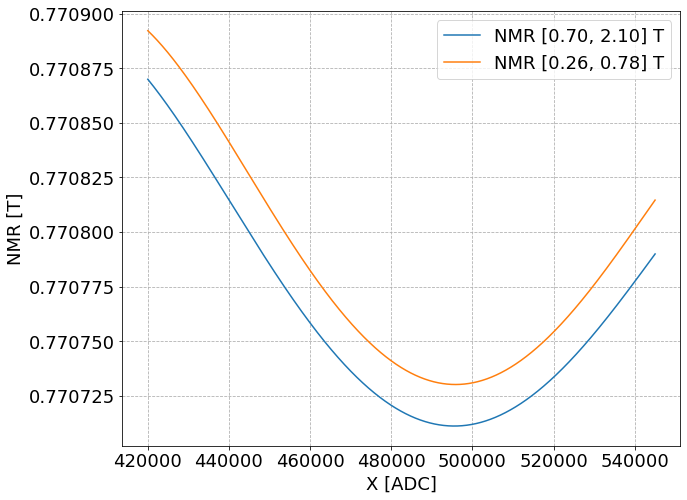

In [538]:
fig, ax = plt.subplots()
ax.plot(xs, ys_high, label='NMR [0.70, 2.10] T')
ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR [T]')
ax.legend();

In [541]:
poly_low(440000)-poly_high(440000)

2.6144716800069467e-05

In [542]:
(x0_low - x0_high)

149

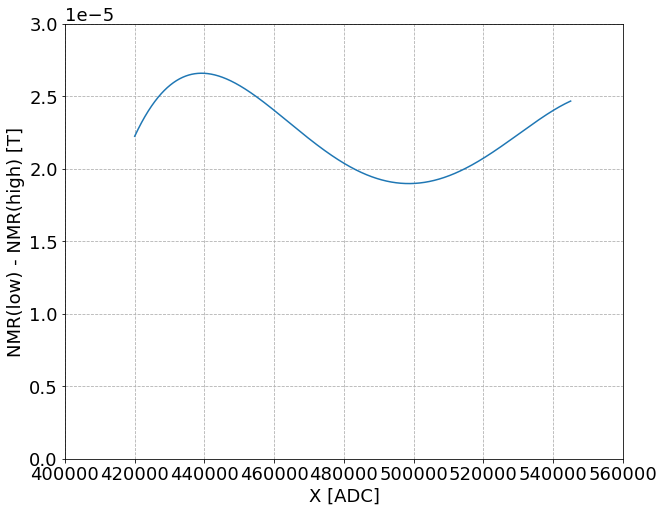

In [543]:
fig, ax = plt.subplots()
ax.plot(xs, ys_low-ys_high)#, label='NMR [0.70, 2.10] T')
# ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR(low) - NMR(high) [T]')
ax.set_xlim([400000, 560000])
ax.set_ylim([0, 3e-5]);
# ax.legend();